In [1]:
import numpy as np
from numpy import math
from statistics import mean
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn import preprocessing
from sklearn import datasets
import mpl_toolkits
from sklearn.linear_model import LinearRegression
from statsmodels.formula.api import ols
import statsmodels.formula.api as sm
import statsmodels.stats.api as sms
import statsmodels.formula.api as smf
import scipy.stats as stats
plt.style.use('ggplot')
from sklearn.preprocessing import OneHotEncoder

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
#import tensorflow as tf
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error


In [2]:
import pandas as pd

df=pd.read_csv('raw-data.csv',encoding='latin1')

print(df.head())


   Row ID        Order ID  Order Date   Ship Date       Ship Mode Customer ID  \
0       1  CA-2016-152156   11/8/2016  11/11/2016    Second Class    CG-12520   
1       2  CA-2016-152156   11/8/2016  11/11/2016    Second Class    CG-12520   
2       3  CA-2016-138688   6/12/2016   6/16/2016    Second Class    DV-13045   
3       4  US-2015-108966  10/11/2015  10/18/2015  Standard Class    SO-20335   
4       5  US-2015-108966  10/11/2015  10/18/2015  Standard Class    SO-20335   

     Customer Name    Segment        Country             City  ...  \
0      Claire Gute   Consumer  United States        Henderson  ...   
1      Claire Gute   Consumer  United States        Henderson  ...   
2  Darrin Van Huff  Corporate  United States      Los Angeles  ...   
3   Sean O'Donnell   Consumer  United States  Fort Lauderdale  ...   
4   Sean O'Donnell   Consumer  United States  Fort Lauderdale  ...   

  Postal Code  Region       Product ID         Category Sub-Category  \
0       42420   Sout

In [3]:
df.head()

,Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,Country,City,...,Postal Code,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit
0,1,CA-2016-152156,11/8/2016,11/11/2016,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-BO-10001798,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,2,0.00,41.9136
1,2,CA-2016-152156,11/8/2016,11/11/2016,Second Class,CG-12520,Claire Gute,Consumer,United States,Henderson,...,42420,South,FUR-CH-10000454,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,3,0.00,219.5820
2,3,CA-2016-138688,6/12/2016,6/16/2016,Second Class,DV-13045,Darrin Van Huff,Corporate,United States,Los Angeles,...,90036,West,OFF-LA-10000240,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,2,0.00,6.8714
3,4,US-2015-108966,10/11/2015,10/18/2015,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,...,33311,South,FUR-TA-10000577,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,5,0.45,-383.0310
4,5,US-2015-108966,10/11/2015,10/18/2015,Standard Class,SO-20335,Sean O'Donnell,Consumer,United States,Fort Lauderdale,...,33311,South,OFF-ST-10000760,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2,0.20,2.5164


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Row ID         9994 non-null   int64  
 1   Order ID       9994 non-null   object 
 2   Order Date     9994 non-null   object 
 3   Ship Date      9994 non-null   object 
 4   Ship Mode      9994 non-null   object 
 5   Customer ID    9994 non-null   object 
 6   Customer Name  9994 non-null   object 
 7   Segment        9994 non-null   object 
 8   Country        9994 non-null   object 
 9   City           9994 non-null   object 
 10  State          9994 non-null   object 
 11  Postal Code    9994 non-null   int64  
 12  Region         9994 non-null   object 
 13  Product ID     9994 non-null   object 
 14  Category       9994 non-null   object 
 15  Sub-Category   9994 non-null   object 
 16  Product Name   9994 non-null   object 
 17  Sales          9994 non-null   float64
 18  Quantity

In [5]:
df.describe()

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
count,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000,9994.000000
mean,4997.500000,55190.379428,229.858001,3.789574,0.156203,28.656896
std,2885.163629,32063.693350,623.245101,2.225110,0.206452,234.260108
min,1.000000,1040.000000,0.444000,1.000000,0.000000,-6599.978000
25%,2499.250000,23223.000000,17.280000,2.000000,0.000000,1.728750
50%,4997.500000,56430.500000,54.490000,3.000000,0.200000,8.666500
75%,7495.750000,90008.000000,209.940000,5.000000,0.200000,29.364000
max,9994.000000,99301.000000,22638.480000,14.000000,0.800000,8399.976000


In [6]:
#group by Region 
data=df.groupby(['Region']).mean()
data

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Region,,,,,,
Central,5030.547998,65340.572536,215.772661,3.779595,0.240353,17.092709
East,4941.685042,17616.466994,238.336110,3.728230,0.145365,32.135808
South,5069.935185,34490.772840,241.803645,3.832716,0.147253,28.857673
West,4986.524508,91707.696534,226.493233,3.829535,0.109335,33.849032


In [7]:
#group by Region 
df_R = df.groupby('Region').agg({'Sales':'sum', 'Profit':'sum'})
df_R

,Sales,Profit
Region,,
Central,501239.8908,39706.3625
East,678781.2400,91522.7800
South,391721.9050,46749.4303
West,725457.8245,108418.4489


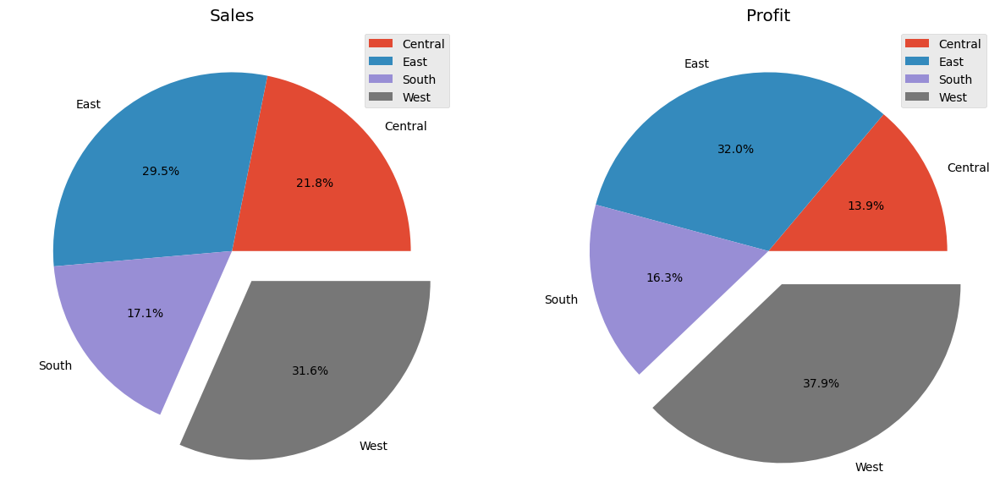

In [176]:
#region pie chart Sales and Profit
fig, axs = plt.subplots(1, 2)

g1 = df_R.plot.pie(y='Sales', figsize=(15,15), ax=axs[0], autopct='%1.1f%%', explode=[0,0,0,0.2,])
g1.set_title('Sales')
g2 = df_R.plot.pie(y='Profit', figsize=(15,15), ax=axs[1], autopct='%1.1f%%', explode=[0,0,0,0.2,])
g2.set_title('Profit')
g1.set_ylabel(None)
g2.set_ylabel(None)

plt.show()

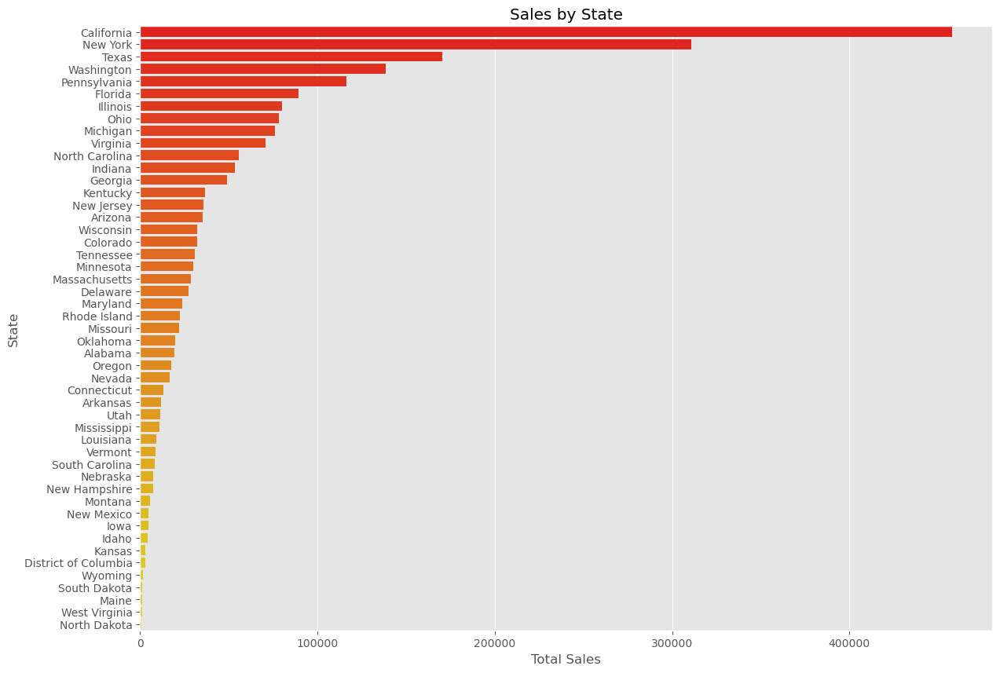

In [9]:
#Plot Sales by State
figure = plt.figure(figsize=(14,10))

grouped_df = df.groupby('State').sum()[['Sales']].reset_index().sort_values(by='Sales', ascending=False)
g = sns.barplot(x='Sales', y='State', data=grouped_df, palette = 'autumn')
g.set_title('Sales by State')
g.set_xlabel('Total Sales')
plt.show(g) 

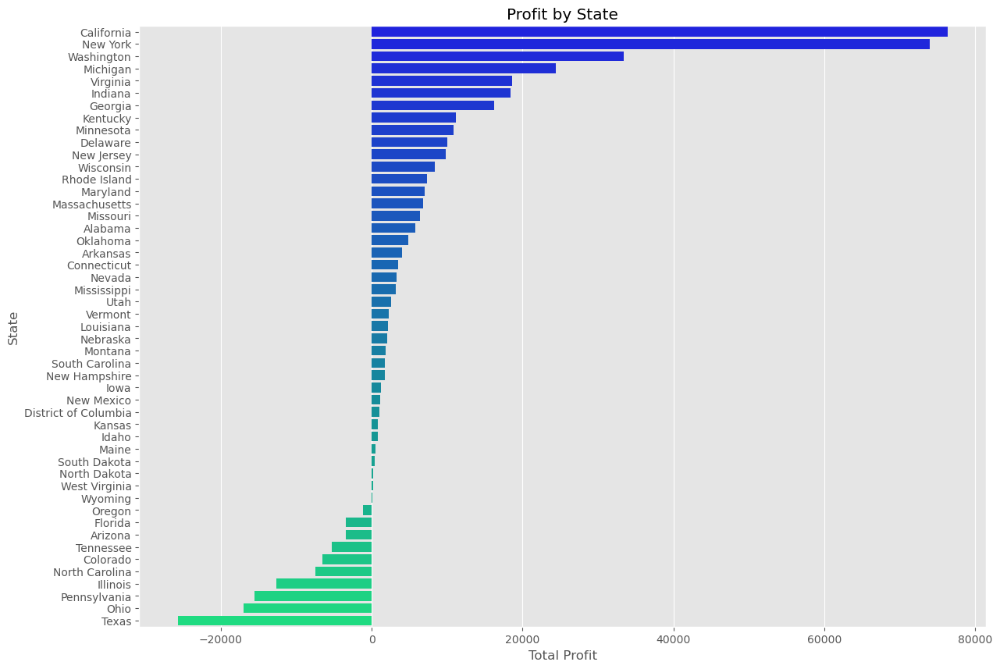

In [10]:
#Total Profit by State
figure = plt.figure(figsize=(14,10))

grouped_df = df.groupby('State').sum()[['Profit']].reset_index().sort_values(by='Profit', ascending=False)
g = sns.barplot(x='Profit', y='State', data=grouped_df, palette='winter')
g.set_title('Profit by State')
g.set_xlabel('Total Profit')
plt.show(g)


In [170]:
grouped_df = df.groupby('State').sum()[['Profit']].reset_index().sort_values(by='Profit', ascending=False)
grouped_df.head()

,State,Profit
3,California,76381.3871
30,New York,74038.5486
45,Washington,33402.6517
20,Michigan,24463.1876
44,Virginia,18597.9504


In [171]:
states_neg_pro = ['Oregon', 'Florida', 'Arizona', 'Tenessee', 'Colorado', 'North Carolina', 'Illinois', 'Pennsylvania', 'Ohio', 'Texas']
states_neg_pro_df = df[df['State'].isin(states_neg_pro)]
states_neg_pro_df.head()

,Ship Mode,Segment,State,Postal Code,Region,Category,Sub-Category,Product Name,Sales,Profit,Order Date_year,Order Date_month,Ship Date_year,Ship Date_month
3,Standard Class,Consumer,Florida,33311,South,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,-383.0310,2015,10,2015,10
4,Standard Class,Consumer,Florida,33311,South,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2.5164,2015,10,2015,10
12,Standard Class,Consumer,North Carolina,28027,South,Office Supplies,Paper,Xerox 1967,15.5520,5.4432,2017,4,2017,4
14,Standard Class,Home Office,Texas,76106,Central,Office Supplies,Appliances,Holmes Replacement Filter for HEPA Air Cleaner...,68.8100,-123.8580,2015,11,2015,11
15,Standard Class,Home Office,Texas,76106,Central,Office Supplies,Binders,Storex DuraTech Recycled Plastic Frosted Binders,2.5440,-3.8160,2015,11,2015,11


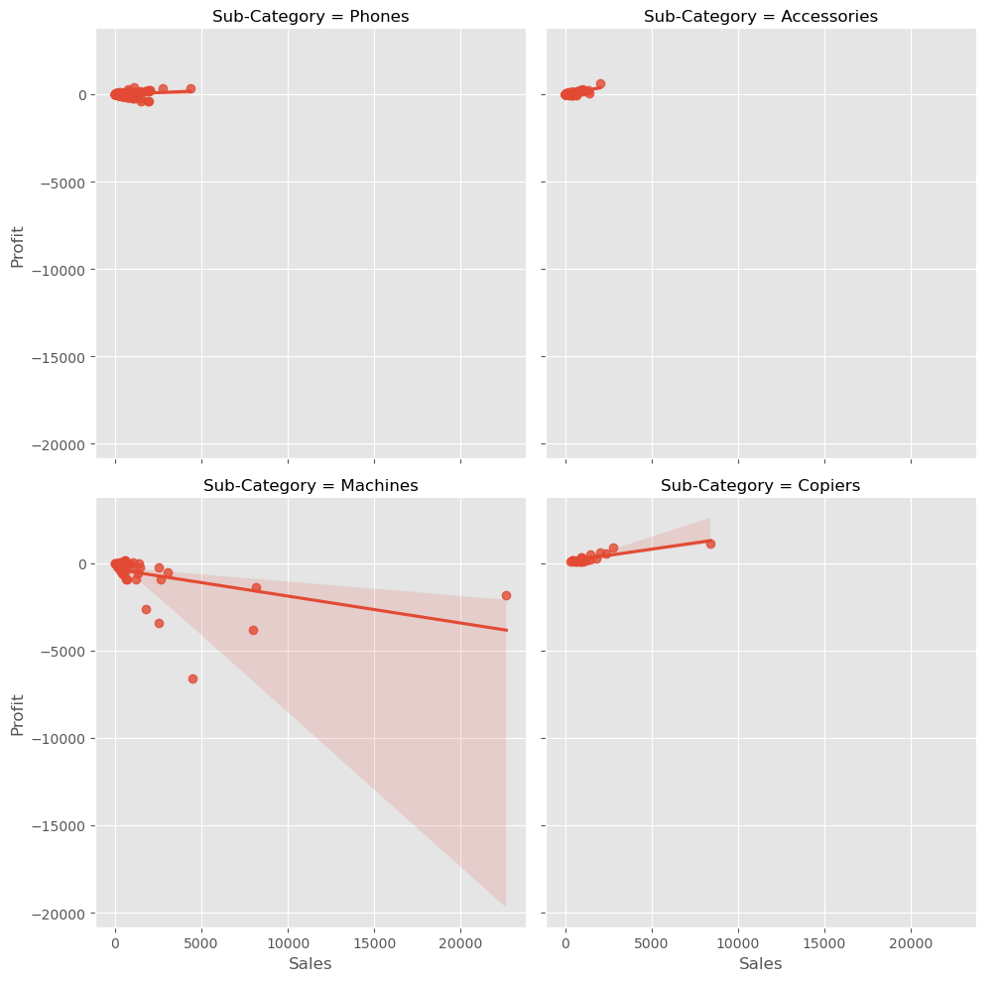

In [172]:
states_neg_pro_df1 = states_neg_pro_df[states_neg_pro_df['Category']=='Technology']
g = sns.lmplot(
    data=states_neg_pro_df1,
    x="Sales", y="Profit", col='Sub-Category',
    height=5, aspect=1, col_wrap=2
)
g.add_legend()
plt.show()

In [11]:
#Group by City
data1=df.groupby(['City']).mean()
data1

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
City,,,,,,
Aberdeen,9261.000000,57401.0,25.500000,3.000000,0.000000,6.630000
Abilene,6990.000000,79605.0,1.392000,2.000000,0.800000,-3.758400
Akron,4630.190476,44312.0,129.999333,3.095238,0.357143,-8.887410
Albuquerque,4798.214286,87105.0,158.582857,4.642857,0.057143,45.292007
Alexandria,2993.625000,22304.0,344.973125,5.250000,0.000000,19.913644
...,...,...,...,...,...,...
Woonsocket,4862.000000,2895.0,48.887500,3.750000,0.000000,19.669775
Yonkers,4941.466667,10701.0,510.511067,3.800000,0.066667,184.517047
York,4678.400000,17403.0,163.595600,3.800000,0.420000,-20.433840


In [12]:
#City ascending false 
data1=data1.sort_values(by='City' ,ascending=False)
data1

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
City,,,,,,
Yuma,6868.250000,85364.0,210.216250,5.500000,0.450000,-116.497725
Yucaipa,3348.000000,92399.0,50.800000,5.000000,0.000000,13.208000
York,4678.400000,17403.0,163.595600,3.800000,0.420000,-20.433840
Yonkers,4941.466667,10701.0,510.511067,3.800000,0.066667,184.517047
Woonsocket,4862.000000,2895.0,48.887500,3.750000,0.000000,19.669775
...,...,...,...,...,...,...
Alexandria,2993.625000,22304.0,344.973125,5.250000,0.000000,19.913644
Albuquerque,4798.214286,87105.0,158.582857,4.642857,0.057143,45.292007
Akron,4630.190476,44312.0,129.999333,3.095238,0.357143,-8.887410


In [13]:
data1=data1.head(15)

<AxesSubplot:ylabel='City'>

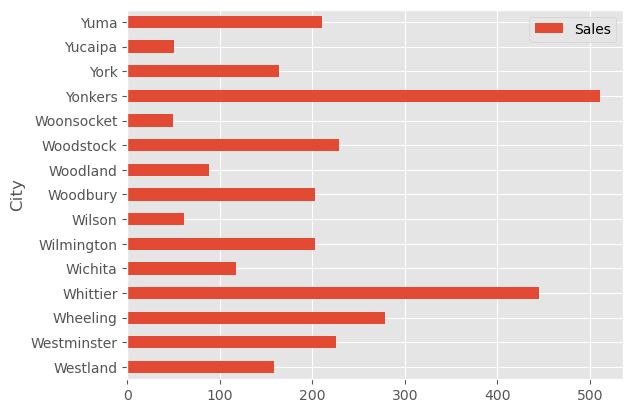

In [14]:
#plot City top 15
table2 = pd.pivot_table(data1,index='City',values=['Sales'])
table2.plot.barh()

In [195]:
#Group by Sub-Category
data3=df.groupby(['Region']).mean()
data

,cc
pairs,
"(Region_West, Region_West)",1.000000
"(Ship Date_year_2016, Order Date_year_2016)",0.985122
"(Order Date_year_2017, Ship Date_year_2017)",0.983056
"(Order Date_year_2015, Ship Date_year_2015)",0.976959
"(State_California, Region_West)",0.728546
"(Category_Technology, Sub-Category_Phones)",0.656261
"(Category_Technology, Category_Office Supplies)",0.586764
"(Region_East, State_New York)",0.565005
"(Region_South, State_Florida)",0.453862


<AxesSubplot:ylabel='Region'>

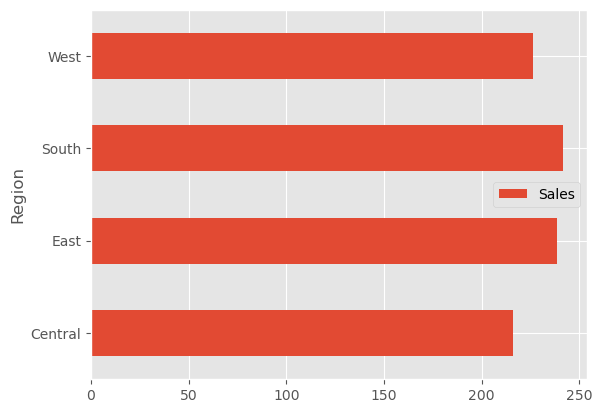

In [197]:
#Plot Sub-Category
table3 = pd.pivot_table(data3,index='Region',values=['Sales'])
table3.plot.barh()

Binders        1523
Paper          1370
Furnishings     957
Phones          889
Storage         846
Art             796
Accessories     775
Chairs          617
Appliances      466
Labels          364
Tables          319
Envelopes       254
Bookcases       228
Fasteners       217
Supplies        190
Machines        115
Copiers          68
Name: Sub-Category, dtype: int64


<AxesSubplot:title={'center':'Sub-Category'}, ylabel='Sub-Category'>

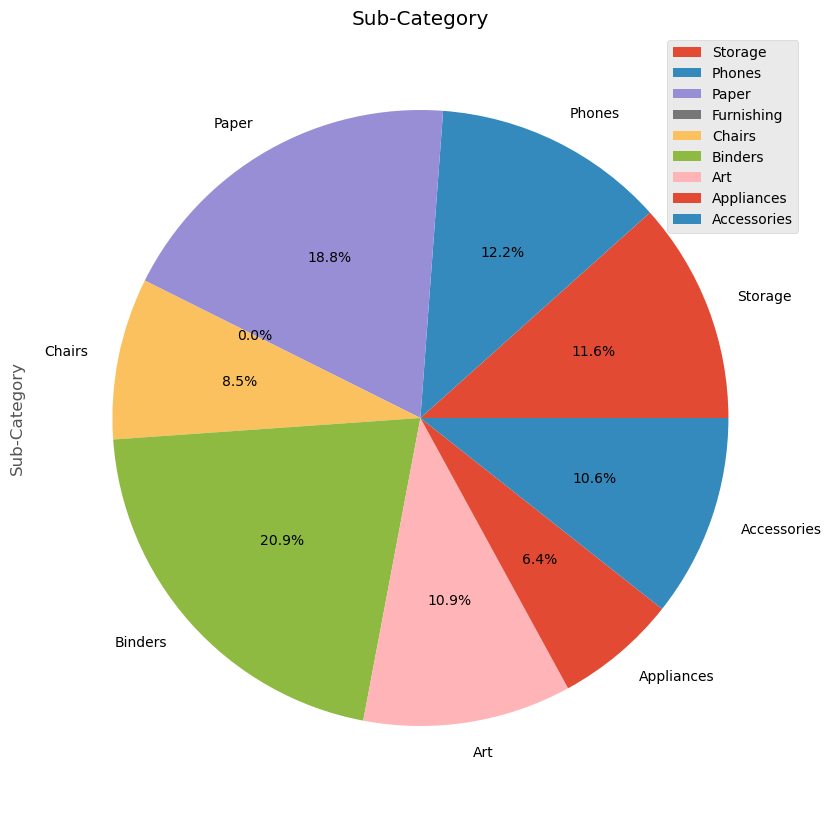

In [193]:
## Number of products in each category 
type_counts = df['Sub-Category'].value_counts()

print(type_counts)

df2 = pd.DataFrame({'Sub-Category': type_counts}, 
                     index = ['Storage', 'Phones', 'Paper','Furnishing', 'Chairs',
                              'Binders', 'Art', 'Appliances', 'Accessories']
                   )
df2.plot.pie(y='Sub-Category', figsize=(10,10), autopct='%1.1f%%', title='Sub-Category')


In [18]:
#Group by Category
data4=df.groupby(['Category']).mean()
data4

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Category,,,,,,
Furniture,5041.643564,55726.556341,349.834887,3.785007,0.173923,8.699327
Office Supplies,4980.175075,54890.951211,119.324101,3.801195,0.157285,20.327050
Technology,5003.331890,55551.572279,452.709276,3.756903,0.132323,78.752002


<AxesSubplot:ylabel='Category'>

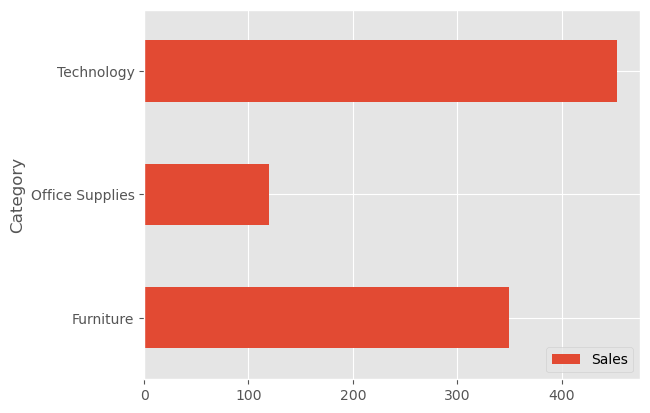

In [19]:
#Plot Category
table4 = pd.pivot_table(data4,index='Category',values=['Sales'])
table4.plot.barh()

<AxesSubplot:ylabel='Category'>

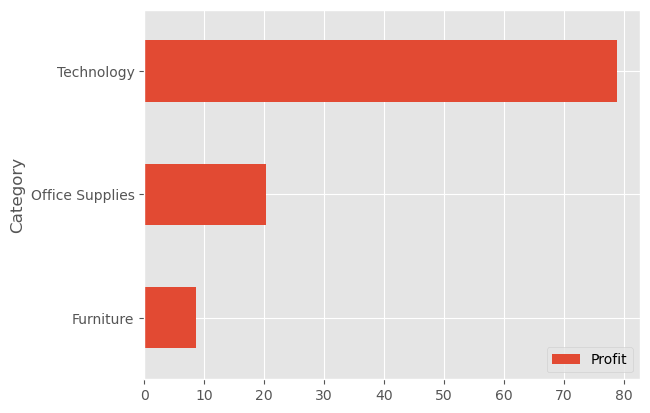

In [194]:
#Plot Category
table4 = pd.pivot_table(data4,index='Category',values=['Profit'])
table4.plot.barh()

Office Supplies    6026
Furniture          2121
Technology         1847
Name: Category, dtype: int64


<AxesSubplot:ylabel='Category'>

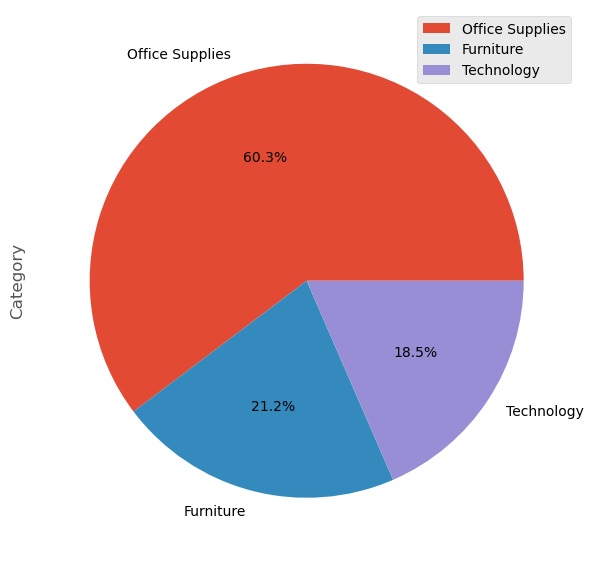

In [174]:
## Number of products in each category 
type_counts = df['Category'].value_counts()

print(type_counts)

df2 = pd.DataFrame({'Category': type_counts}, 
                     index = [ 'Office Supplies', 'Furniture','Technology']
                   )
df2.plot.pie(y='Category', figsize=(7,10), autopct='%1.1f%%')

In [21]:
data5=df.groupby(['Sub-Category']).mean()
data5.head(10)

,Row ID,Postal Code,Sales,Quantity,Discount,Profit
Sub-Category,,,,,,
Accessories,5068.490323,57378.624516,215.974604,3.840000,0.078452,54.111788
Appliances,5166.854077,54185.703863,230.755710,3.710300,0.166524,38.922758
Art,4924.760050,54434.243719,34.068834,3.768844,0.074874,8.200737
Binders,5012.432699,54908.994091,133.560560,3.922521,0.372292,19.843574
Bookcases,5072.521930,56015.521930,503.859633,3.807018,0.211140,-15.230509
Chairs,5059.162075,56622.737439,532.332420,3.818476,0.170178,43.095894
Copiers,5230.308824,56962.897059,2198.941618,3.441176,0.161765,817.909190
Envelopes,4755.523622,52463.507874,64.867724,3.566929,0.080315,27.418019
Fasteners,4687.958525,57631.626728,13.936774,4.211982,0.082028,4.375660


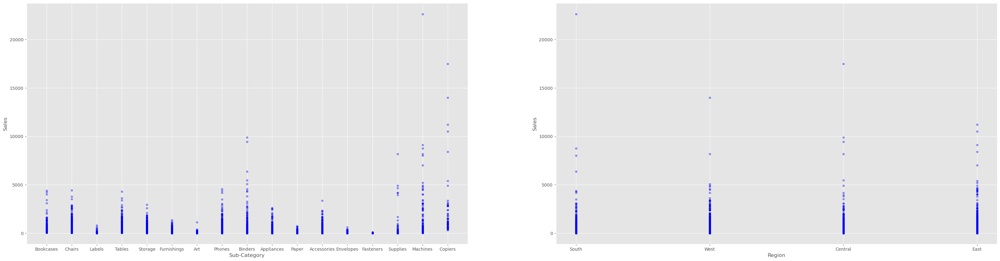

In [22]:
#Scatter plot 
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(40,10))
for xcol, ax in zip(['Sub-Category', 'Region'], axes):
    df.plot(kind='scatter', x=xcol, y='Sales', ax=ax, alpha=0.4, color='b')


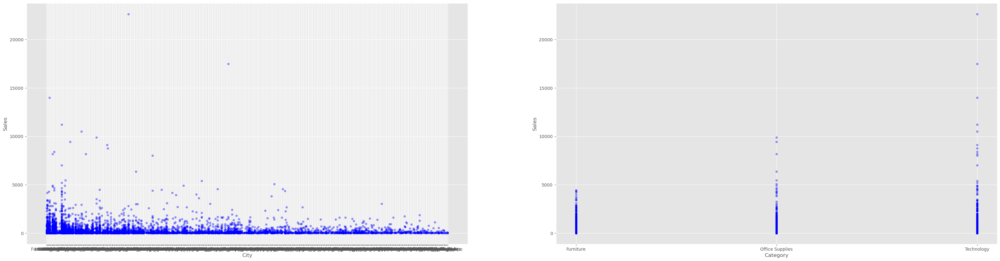

In [23]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(40,10))
for xcol, ax in zip(['City','Category'], axes):
    df.plot(kind='scatter', x=xcol, y='Sales', ax=ax, alpha=0.4, color='b')

In [24]:
#Drop uneccessary columns 
df=df.drop(['Row ID', 'Order ID', 'Customer ID', 'Customer Name',
            'Country', 'City', 'Product ID', 'Discount', 'Quantity'], axis=1)
df

,Order Date,Ship Date,Ship Mode,Segment,State,Postal Code,Region,Category,Sub-Category,Product Name,Sales,Profit
0,11/8/2016,11/11/2016,Second Class,Consumer,Kentucky,42420,South,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,41.9136
1,11/8/2016,11/11/2016,Second Class,Consumer,Kentucky,42420,South,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,219.5820
2,6/12/2016,6/16/2016,Second Class,Corporate,California,90036,West,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,6.8714
3,10/11/2015,10/18/2015,Standard Class,Consumer,Florida,33311,South,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,-383.0310
4,10/11/2015,10/18/2015,Standard Class,Consumer,Florida,33311,South,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2.5164
...,...,...,...,...,...,...,...,...,...,...,...,...
9989,1/21/2014,1/23/2014,Second Class,Consumer,Florida,33180,South,Furniture,Furnishings,Ultra Door Pull Handle,25.2480,4.1028
9990,2/26/2017,3/3/2017,Standard Class,Consumer,California,92627,West,Furniture,Furnishings,Tenex B1-RE Series Chair Mats for Low Pile Car...,91.9600,15.6332
9991,2/26/2017,3/3/2017,Standard Class,Consumer,California,92627,West,Technology,Phones,Aastra 57i VoIP phone,258.5760,19.3932
9992,2/26/2017,3/3/2017,Standard Class,Consumer,California,92627,West,Office Supplies,Paper,"It's Hot Message Books with Stickers, 2 3/4"" x 5""",29.6000,13.3200


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Order Date    9994 non-null   object 
 1   Ship Date     9994 non-null   object 
 2   Ship Mode     9994 non-null   object 
 3   Segment       9994 non-null   object 
 4   State         9994 non-null   object 
 5   Postal Code   9994 non-null   int64  
 6   Region        9994 non-null   object 
 7   Category      9994 non-null   object 
 8   Sub-Category  9994 non-null   object 
 9   Product Name  9994 non-null   object 
 10  Sales         9994 non-null   float64
 11  Profit        9994 non-null   float64
dtypes: float64(2), int64(1), object(9)
memory usage: 937.1+ KB


In [26]:
{columns: len(df[columns].unique()) for columns in df.columns}

{'Order Date': 1237,
 'Ship Date': 1334,
 'Ship Mode': 4,
 'Segment': 3,
 'State': 49,
 'Postal Code': 631,
 'Region': 4,
 'Category': 3,
 'Sub-Category': 17,
 'Product Name': 1850,
 'Sales': 5825,
 'Profit': 7287}

In [27]:
def onehot_encode (df, column):
    dummies = pd.get_dummies (df=[column], prefix=column)
    df = pd.concat ([df.dummies], axis =1)
    df = df.drop(column, axis=1)
    for column in ['Ship Mode', 'State', 'Region', 'Category', 'Sub-Category']:
        df = onehot_encode (df, column = column)
    return df


In [28]:
def encode_dates(df, column):
    
    df[column]= pd.to_datetime (df[column])
    df[column + '_year'] = df [column].apply (lambda x : x.year)
    df[column + '_month'] = df [column].apply (lambda x : x.month)
    df[column + '_day'] = df [column].apply (lambda x : x.day)
    df = df.drop(column, axis = 1)
    return df

In [29]:
def preprocess_inputs(df):
    df=df.copy()
    
    #Extract date features
    
    df = encode_dates (df, 'Order Date')
    df = encode_dates (df, 'Ship Date')
    
    
    return df

In [30]:
df=preprocess_inputs(df)

In [31]:
#Drop uneccessary columns 
df=df.drop(['Order Date_day', 'Ship Date_day'], axis=1)
df

,Ship Mode,Segment,State,Postal Code,Region,Category,Sub-Category,Product Name,Sales,Profit,Order Date_year,Order Date_month,Ship Date_year,Ship Date_month
0,Second Class,Consumer,Kentucky,42420,South,Furniture,Bookcases,Bush Somerset Collection Bookcase,261.9600,41.9136,2016,11,2016,11
1,Second Class,Consumer,Kentucky,42420,South,Furniture,Chairs,"Hon Deluxe Fabric Upholstered Stacking Chairs,...",731.9400,219.5820,2016,11,2016,11
2,Second Class,Corporate,California,90036,West,Office Supplies,Labels,Self-Adhesive Address Labels for Typewriters b...,14.6200,6.8714,2016,6,2016,6
3,Standard Class,Consumer,Florida,33311,South,Furniture,Tables,Bretford CR4500 Series Slim Rectangular Table,957.5775,-383.0310,2015,10,2015,10
4,Standard Class,Consumer,Florida,33311,South,Office Supplies,Storage,Eldon Fold 'N Roll Cart System,22.3680,2.5164,2015,10,2015,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,Second Class,Consumer,Florida,33180,South,Furniture,Furnishings,Ultra Door Pull Handle,25.2480,4.1028,2014,1,2014,1
9990,Standard Class,Consumer,California,92627,West,Furniture,Furnishings,Tenex B1-RE Series Chair Mats for Low Pile Car...,91.9600,15.6332,2017,2,2017,3
9991,Standard Class,Consumer,California,92627,West,Technology,Phones,Aastra 57i VoIP phone,258.5760,19.3932,2017,2,2017,3
9992,Standard Class,Consumer,California,92627,West,Office Supplies,Paper,"It's Hot Message Books with Stickers, 2 3/4"" x 5""",29.6000,13.3200,2017,2,2017,3


In [137]:
df_time = df[['Sales', 'Order Date_year', 'Order Date_month', 'Ship Date_year', 'Ship Date_month']]
df_time

,Sales,Order Date_year,Order Date_month,Ship Date_year,Ship Date_month
0,261.9600,2016,11,2016,11
1,731.9400,2016,11,2016,11
2,14.6200,2016,6,2016,6
3,957.5775,2015,10,2015,10
4,22.3680,2015,10,2015,10
5,48.8600,2014,6,2014,6
6,7.2800,2014,6,2014,6
7,907.1520,2014,6,2014,6
8,18.5040,2014,6,2014,6
9,114.9000,2014,6,2014,6


<AxesSubplot:xlabel='Order Date_month', ylabel='Sales'>

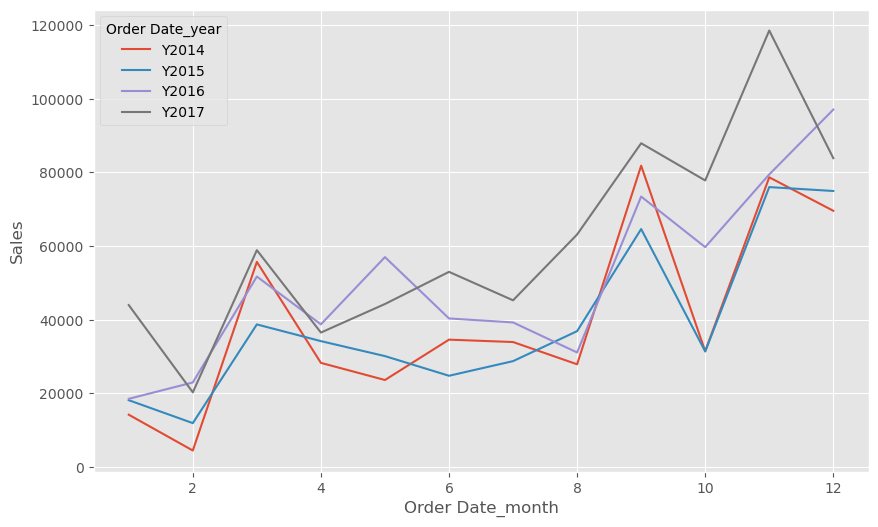

In [158]:
each_month = df.groupby(['Order Date_year', 'Order Date_month'])['Sales'].sum().reset_index()
each_month['Order Date_year'] = 'Y' + each_month['Order Date_year'].astype(str)
plt.figure(figsize=(10,6))
sns.lineplot(x='Order Date_month', y='Sales', hue='Order Date_year', data=each_month)

<AxesSubplot:xlabel='Ship Date_month', ylabel='Sales'>

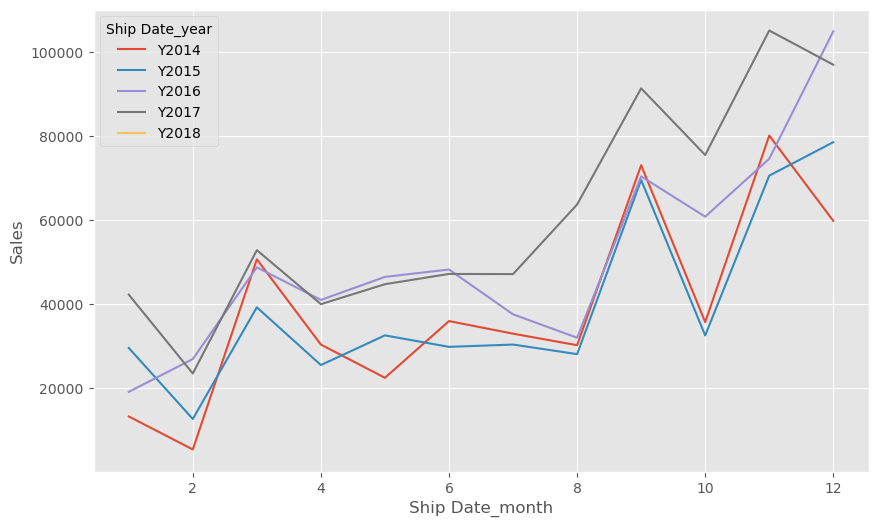

In [168]:
each_month = df.groupby(['Ship Date_year', 'Ship Date_month'])['Sales'].sum().reset_index()
each_month['Ship Date_year'] = 'Y' + each_month['Ship Date_year'].astype(str)
plt.figure(figsize=(10,6))
sns.lineplot(x='Ship Date_month', y='Sales', hue='Ship Date_year', data=each_month)

Dummies

In [33]:
df1 = pd.get_dummies(df, columns= ['Ship Mode'], prefix = 'Ship Mode', drop_first= True)

In [34]:
df2 = pd.get_dummies(df, columns= ['State'], prefix = 'State', drop_first= True)

In [35]:
df3 = pd.get_dummies(df, columns= ['Region'], prefix = 'Region', drop_first= True)

In [36]:
df4 = pd.get_dummies(df, columns= ['Category'], prefix = 'Category', drop_first= True)

In [37]:
df5 = pd.get_dummies(df, columns= ['Sub-Category'], prefix = 'Sub-Category', drop_first= True)

In [38]:
df6 = pd.get_dummies(df, columns= ['Order Date_year'], prefix = 'Order Date_year', drop_first= True)

In [39]:
df7 = pd.get_dummies(df, columns= ['Ship Date_year'], prefix = 'Ship Date_year', drop_first= True)

In [40]:
df8 = pd.get_dummies(df, columns= ['Product Name'], prefix = 'Product Name', drop_first= True)

In [41]:
df9 = pd.get_dummies(df, columns= ['Postal Code'], prefix = 'Postal Code', drop_first= True)

In [42]:
df1=df1.drop(['Postal Code', 'Product Name','Segment','State', 'Region', 'Category', 'Sub-Category','Order Date_year', 'Ship Date_year'], axis=1)
df1

,Sales,Profit,Order Date_month,Ship Date_month,Ship Mode_Same Day,Ship Mode_Second Class,Ship Mode_Standard Class
0,261.9600,41.9136,11,11,0,1,0
1,731.9400,219.5820,11,11,0,1,0
2,14.6200,6.8714,6,6,0,1,0
3,957.5775,-383.0310,10,10,0,0,1
4,22.3680,2.5164,10,10,0,0,1
...,...,...,...,...,...,...,...
9989,25.2480,4.1028,1,1,0,1,0
9990,91.9600,15.6332,2,3,0,0,1
9991,258.5760,19.3932,2,3,0,0,1
9992,29.6000,13.3200,2,3,0,0,1


In [43]:
df2=df2.drop(['Postal Code', 'Product Name','Segment','Ship Mode','Region', 'Category', 'Sub-Category','Sales', 'Profit', 'Order Date_year', 'Ship Date_year'], axis=1)
df2

,Order Date_month,Ship Date_month,State_Arizona,State_Arkansas,State_California,State_Colorado,State_Connecticut,State_Delaware,State_District of Columbia,State_Florida,...,State_South Dakota,State_Tennessee,State_Texas,State_Utah,State_Vermont,State_Virginia,State_Washington,State_West Virginia,State_Wisconsin,State_Wyoming
0,11,11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,11,11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,6,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10,10,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,10,10,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
9990,2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9991,2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9992,2,3,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [44]:
df3=df3.drop(['Postal Code', 'Product Name','Segment','Ship Mode','State', 'Category', 'Sub-Category', 'Sales', 'Profit','Order Date_year', 'Ship Date_year'], axis=1)
df3

,Order Date_month,Ship Date_month,Region_East,Region_South,Region_West
0,11,11,0,1,0
1,11,11,0,1,0
2,6,6,0,0,1
3,10,10,0,1,0
4,10,10,0,1,0
...,...,...,...,...,...
9989,1,1,0,1,0
9990,2,3,0,0,1
9991,2,3,0,0,1
9992,2,3,0,0,1


In [45]:
df4=df4.drop(['Postal Code', 'Product Name','Segment','Ship Mode','State', 'Region', 'Sub-Category','Sales', 'Profit','Order Date_year', 'Ship Date_year'], axis=1)
df4

,Order Date_month,Ship Date_month,Category_Office Supplies,Category_Technology
0,11,11,0,0
1,11,11,0,0
2,6,6,1,0
3,10,10,0,0
4,10,10,1,0
...,...,...,...,...
9989,1,1,0,0
9990,2,3,0,0
9991,2,3,0,1
9992,2,3,1,0


In [46]:
df5=df5.drop(['Postal Code', 'Product Name','Segment','Ship Mode','State', 'Region', 'Category', 'Sales', 'Profit','Order Date_year', 'Ship Date_year'], axis=1)
df5

,Order Date_month,Ship Date_month,Sub-Category_Appliances,Sub-Category_Art,Sub-Category_Binders,Sub-Category_Bookcases,Sub-Category_Chairs,Sub-Category_Copiers,Sub-Category_Envelopes,Sub-Category_Fasteners,Sub-Category_Furnishings,Sub-Category_Labels,Sub-Category_Machines,Sub-Category_Paper,Sub-Category_Phones,Sub-Category_Storage,Sub-Category_Supplies,Sub-Category_Tables
0,11,11,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,11,11,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,6,6,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,10,10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,10,10,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
9990,2,3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
9991,2,3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
9992,2,3,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [47]:
df6=df6.drop(['Postal Code', 'Product Name','Segment','Ship Mode','State', 'Region', 'Category', 'Sales', 'Profit', 'Ship Date_year', 'Sub-Category'], axis=1)
df6

,Order Date_month,Ship Date_month,Order Date_year_2015,Order Date_year_2016,Order Date_year_2017
0,11,11,0,1,0
1,11,11,0,1,0
2,6,6,0,1,0
3,10,10,1,0,0
4,10,10,1,0,0
...,...,...,...,...,...
9989,1,1,0,0,0
9990,2,3,0,0,1
9991,2,3,0,0,1
9992,2,3,0,0,1


In [48]:
df7=df7.drop(['Postal Code', 'Product Name','Segment','Ship Mode','State', 'Region', 'Category', 'Sales', 'Profit', 'Order Date_year', 'Sub-Category'], axis=1)
df7

,Order Date_month,Ship Date_month,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017,Ship Date_year_2018
0,11,11,0,1,0,0
1,11,11,0,1,0,0
2,6,6,0,1,0,0
3,10,10,1,0,0,0
4,10,10,1,0,0,0
...,...,...,...,...,...,...
9989,1,1,0,0,0,0
9990,2,3,0,0,1,0
9991,2,3,0,0,1,0
9992,2,3,0,0,1,0


In [49]:
df8=df8.drop([ 'Postal Code', 'Ship Date_year', 'Segment','Ship Mode','State', 'Region', 'Category', 'Sales', 'Profit', 'Order Date_year', 'Sub-Category'], axis=1)
df8

,Order Date_month,Ship Date_month,"Product Name_#10 Gummed Flap White Envelopes, 100/Box",Product Name_#10 Self-Seal White Envelopes,"Product Name_#10 White Business Envelopes,4 1/8 x 9 1/2","Product Name_#10- 4 1/8"" x 9 1/2"" Recycled Envelopes","Product Name_#10- 4 1/8"" x 9 1/2"" Security-Tint Envelopes","Product Name_#10-4 1/8"" x 9 1/2"" Premium Diagonal Seam Envelopes",Product Name_#6 3/4 Gummed Flap White Envelopes,"Product Name_1.7 Cubic Foot Compact ""Cube"" Office Refrigerators",...,Product Name_Zebra ZM400 Thermal Label Printer,Product Name_Zebra Zazzle Fluorescent Highlighters,Product Name_Zipper Ring Binder Pockets,Product Name_i.Sound Portable Power - 8000 mAh,Product Name_iHome FM Clock Radio with Lightning Dock,"Product Name_iKross Bluetooth Portable Keyboard + Cell Phone Stand Holder + Brush for Apple iPhone 5S 5C 5, 4S 4",Product Name_iOttie HLCRIO102 Car Mount,Product Name_iOttie XL Car Mount,Product Name_invisibleSHIELD by ZAGG Smudge-Free Screen Protector,Product Name_netTALK DUO VoIP Telephone Service
0,11,11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,11,11,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,6,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10,10,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,10,10,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9990,2,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9991,2,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9992,2,3,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [50]:
df9=df9.drop(['Product Name','Segment','Ship Mode','State', 'Region', 'Category', 'Sales', 'Profit', 'Order Date_year', 'Sub-Category'], axis=1)
df9

,Order Date_month,Ship Date_year,Ship Date_month,Postal Code_1453,Postal Code_1752,Postal Code_1810,Postal Code_1841,Postal Code_1852,Postal Code_1915,Postal Code_2038,...,Postal Code_98115,Postal Code_98198,Postal Code_98208,Postal Code_98226,Postal Code_98270,Postal Code_98502,Postal Code_98632,Postal Code_98661,Postal Code_99207,Postal Code_99301
0,11,2016,11,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,11,2016,11,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,2016,6,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10,2015,10,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,10,2015,10,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,1,2014,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9990,2,2017,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9991,2,2017,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9992,2,2017,3,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [51]:
df_dummies=pd.concat([df1, df2, df3, df4, df5, df6, df7, df8, df9], axis =1)
df_dummies

,Sales,Profit,Order Date_month,Ship Date_month,Ship Mode_Same Day,Ship Mode_Second Class,Ship Mode_Standard Class,Order Date_month,Ship Date_month,State_Arizona,...,Postal Code_98115,Postal Code_98198,Postal Code_98208,Postal Code_98226,Postal Code_98270,Postal Code_98502,Postal Code_98632,Postal Code_98661,Postal Code_99207,Postal Code_99301
0,261.9600,41.9136,11,11,0,1,0,11,11,0,...,0,0,0,0,0,0,0,0,0,0
1,731.9400,219.5820,11,11,0,1,0,11,11,0,...,0,0,0,0,0,0,0,0,0,0
2,14.6200,6.8714,6,6,0,1,0,6,6,0,...,0,0,0,0,0,0,0,0,0,0
3,957.5775,-383.0310,10,10,0,0,1,10,10,0,...,0,0,0,0,0,0,0,0,0,0
4,22.3680,2.5164,10,10,0,0,1,10,10,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,25.2480,4.1028,1,1,0,1,0,1,1,0,...,0,0,0,0,0,0,0,0,0,0
9990,91.9600,15.6332,2,3,0,0,1,2,3,0,...,0,0,0,0,0,0,0,0,0,0
9991,258.5760,19.3932,2,3,0,0,1,2,3,0,...,0,0,0,0,0,0,0,0,0,0
9992,29.6000,13.3200,2,3,0,0,1,2,3,0,...,0,0,0,0,0,0,0,0,0,0


In [52]:
#Split df into x and y
y = df_dummies ['Sales']
X = df_dummies.drop ('Sales', axis =1)

In [53]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, shuffle=True, random_state=1)

In [54]:
#import LinearRegression
from sklearn.linear_model import LinearRegression

In [55]:
lm = LinearRegression()

In [56]:
lm.fit(X_train,y_train)

LinearRegression()

In [57]:
#intercept
print(lm.intercept_)


-169822192735768.25


In [58]:
#Coefficient
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

,Coefficient
Profit,1.038982e+00
Order Date_month,-5.566287e+09
Ship Date_month,-4.805459e+08
Ship Mode_Same Day,8.771117e+00
Ship Mode_Second Class,9.889060e+00
...,...
Postal Code_98502,1.448606e+07
Postal Code_98632,1.448591e+07
Postal Code_98661,1.448588e+07
Postal Code_99207,1.448608e+07


In [59]:
#predict test
pred = lm.predict(X_test)
pred

array([ 371.0625 ,   91.125  ,   -2.28125, ..., 1911.34375,   40.     ,
        214.78125])

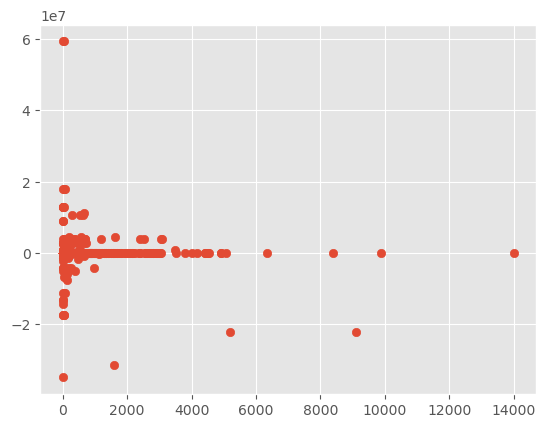

In [60]:
#scatter plot
plt.scatter(y_test,pred)

In [61]:
#add constant to predictor variables
import statsmodels.api as sm
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Sales   R-squared:                       0.893
Model:                            OLS   Adj. R-squared:                  0.857
Method:                 Least Squares   F-statistic:                     25.11
Date:                Sat, 25 Feb 2023   Prob (F-statistic):               0.00
Time:                        18:24:03   Log-Likelihood:                -67325.
No. Observations:                9994   AIC:                         1.396e+05
Df Residuals:                    7501   BIC:                         1.576e+05
Df Model:                        2492                                         
Covariance Type:            nonrobust                                         
                                                                                                                                                   coef    std err          t      P>|t|      [0.025      0.975]
-

In [62]:
#df_dummies2 = df_dummies 

In [63]:
df_dummies2=df_dummies.drop(['Ship Mode_Same Day', 'Ship Mode_Second Class', 'Ship Mode_Standard Class', 'State_Arizona', 
                             'State_Connecticut', 'State_Arkansas','State_Kentucky','State_Delaware', 'State_District of Columbia', 'State_Idaho', 'State_Illinois', 
                             'State_Indiana', 'State_Iowa', 'State_Kansas', 'State_Louisiana', 'State_Maine', 'State_Maryland', 
                             'State_Massachusetts', 'State_Pennsylvania', 'State_Michigan', 'State_Minnesota', 'State_Mississippi', 'State_Missouri', 
                             'State_Montana', 'State_Nebraska', 'State_Nevada', 'State_New Hampshire', 'State_New Jersey', 
                             'State_New Mexico', 'State_Ohio', 'State_Oklahoma', 'State_Oregon', 'State_Rhode Island', 'State_North Dakota',
                             'State_South Carolina', 'State_South Dakota', 'State_Texas', 'State_Utah', 'State_Vermont', 'State_Colorado',
                             'State_West Virginia', 'State_Wisconsin', 'State_Wyoming', 'Sub-Category_Binders', 'Sub-Category_Envelopes',
                             'Ship Date_year_2018', 'Sub-Category_Supplies', 'Sub-Category_Tables'], axis=1)

In [64]:
df_dummies2

,Sales,Profit,Order Date_month,Ship Date_month,Order Date_month,Ship Date_month,State_California,State_Florida,State_Georgia,State_New York,...,Postal Code_98115,Postal Code_98198,Postal Code_98208,Postal Code_98226,Postal Code_98270,Postal Code_98502,Postal Code_98632,Postal Code_98661,Postal Code_99207,Postal Code_99301
0,261.9600,41.9136,11,11,11,11,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,731.9400,219.5820,11,11,11,11,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,14.6200,6.8714,6,6,6,6,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,957.5775,-383.0310,10,10,10,10,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
4,22.3680,2.5164,10,10,10,10,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,25.2480,4.1028,1,1,1,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9990,91.9600,15.6332,2,3,2,3,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9991,258.5760,19.3932,2,3,2,3,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9992,29.6000,13.3200,2,3,2,3,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [65]:
#Split df into x and y
y = df_dummies2 ['Sales']
X = df_dummies2.drop ('Sales', axis =1)

In [66]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state=1)

In [67]:
#import LinearRegression
from sklearn.linear_model import LinearRegression

In [68]:
lm = LinearRegression()

In [69]:
lm.fit(X_train,y_train)

LinearRegression()

In [70]:
#intercept
print(lm.intercept_)


-10517880555.424322


In [71]:
#Coefficient
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

,Coefficient
Profit,9.406827e-01
Order Date_month,-1.287806e+12
Ship Date_month,-3.707659e+11
Order Date_month,2.520013e+11
Ship Date_month,-8.561869e+11
...,...
Postal Code_98502,1.574022e+10
Postal Code_98632,1.574022e+10
Postal Code_98661,1.574022e+10
Postal Code_99207,1.574022e+10


In [72]:
#predict test
pred = lm.predict(X_test)
pred

array([359.40959549,  73.76918602,  82.9631176 , ...,  84.99762917,
        16.25362587,  99.2756176 ])

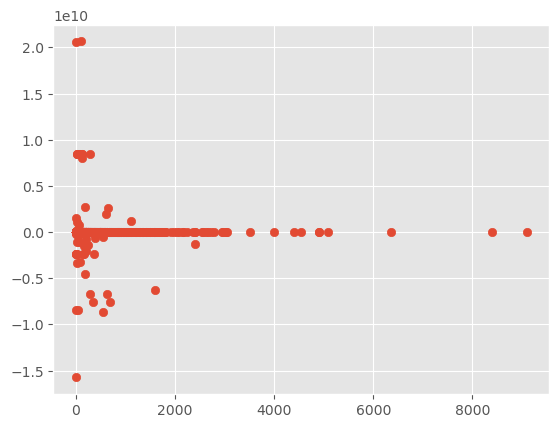

In [73]:
#scatter plot
plt.scatter(y_test,pred)

In [74]:
#add constant to predictor variables
import statsmodels.api as sm
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Sales   R-squared:                       0.893
Model:                            OLS   Adj. R-squared:                  0.857
Method:                 Least Squares   F-statistic:                     25.13
Date:                Sat, 25 Feb 2023   Prob (F-statistic):               0.00
Time:                        18:24:32   Log-Likelihood:                -67329.
No. Observations:                9994   AIC:                         1.396e+05
Df Residuals:                    7504   BIC:                         1.576e+05
Df Model:                        2489                                         
Covariance Type:            nonrobust                                         
                                                                                                                                                   coef    std err          t      P>|t|      [0.025      0.975]
-

/var/folders/17/br7lhr0d49z5kcbl73nl58vh0000gn/T/ipykernel_77474/416555715.py:9: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


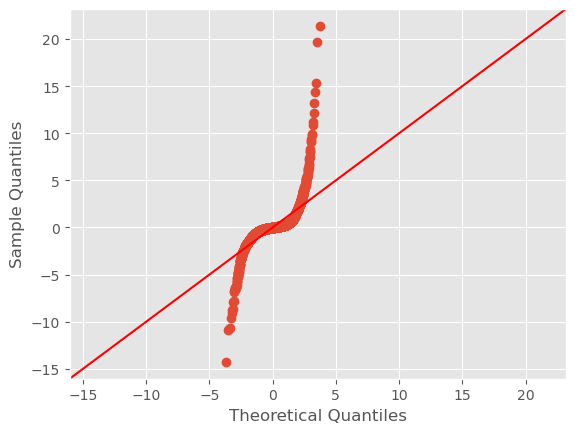

In [75]:
#create the baseline model, using statsmodel
import scipy.stats as stats
import statsmodels as sm
import statsmodels.api as sm


residuals = model.resid
fig = sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True)
fig.show()

/Users/reffer/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


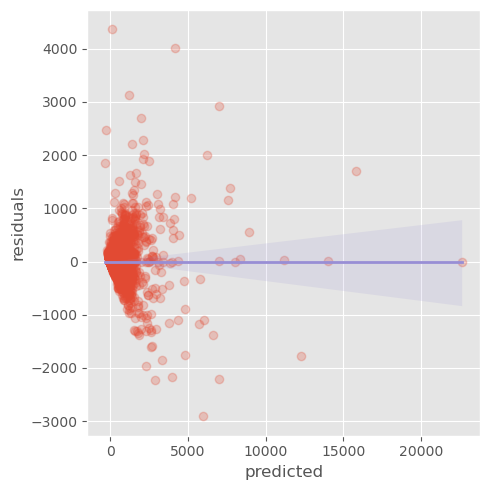

In [76]:
#Homoscedasticity
fig, ax = plt.subplots(figsize=(5, 5))
sns.regplot(model.fittedvalues,model.resid, scatter_kws={'alpha': 0.25}, line_kws={'color': 'C2', 'lw': 2}, ax=ax)
ax.set_xlabel('predicted')
ax.set_ylabel('residuals')
plt.tight_layout()
plt.show()


In [77]:
#Database predictor
data_pred = df_dummies2.iloc[:,1:85]
data_pred.head()

,Profit,Order Date_month,Ship Date_month,Order Date_month,Ship Date_month,State_California,State_Florida,State_Georgia,State_New York,State_North Carolina,...,Product Name_4009 Highlighters,Product Name_4009 Highlighters by Sanford,Product Name_50 Colored Long Pencils,"Product Name_6"" Cubicle Wall Clock, Black",Product Name_9-3/4 Diameter Round Wall Clock,"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",Product Name_ACCOHIDE Binder by Acco,Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,Product Name_AT&T 1070 Corded Phone
0,41.9136,11,11,11,11,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,219.5820,11,11,11,11,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6.8714,6,6,6,6,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,-383.0310,10,10,10,10,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2.5164,10,10,10,10,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [78]:
#correlation
data_pred.corr()

,Profit,Order Date_month,Ship Date_month,Order Date_month,Ship Date_month,State_California,State_Florida,State_Georgia,State_New York,State_North Carolina,...,Product Name_4009 Highlighters,Product Name_4009 Highlighters by Sanford,Product Name_50 Colored Long Pencils,"Product Name_6"" Cubicle Wall Clock, Black",Product Name_9-3/4 Diameter Round Wall Clock,"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",Product Name_ACCOHIDE Binder by Acco,Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,Product Name_AT&T 1070 Corded Phone
Profit,1.000000,-0.000502,-0.000951,-0.000502,-0.000951,0.020323,-0.031985,0.034880,0.056310,-0.040084,...,-0.001107,-0.002650,-0.002108,-0.001888,-0.000697,-0.003814,-0.002036,-0.002247,-0.002781,0.001179
Order Date_month,-0.000502,1.000000,0.911882,1.000000,0.911882,0.020922,-0.017632,-0.047585,0.024615,0.001249,...,-0.020740,-0.008055,-0.012327,0.011821,0.002717,0.001246,0.002683,-0.006977,0.004206,-0.009548
Ship Date_month,-0.000951,0.911882,1.000000,0.911882,1.000000,0.021706,-0.012737,-0.039828,0.026576,0.009409,...,-0.020194,-0.005238,-0.011675,0.012022,0.004295,0.001944,0.004534,-0.006297,0.004534,-0.009043
Order Date_month,-0.000502,1.000000,0.911882,1.000000,0.911882,0.020922,-0.017632,-0.047585,0.024615,0.001249,...,-0.020740,-0.008055,-0.012327,0.011821,0.002717,0.001246,0.002683,-0.006977,0.004206,-0.009548
Ship Date_month,-0.000951,0.911882,1.000000,0.911882,1.000000,0.021706,-0.012737,-0.039828,0.026576,0.009409,...,-0.020194,-0.005238,-0.011675,0.012022,0.004295,0.001944,0.004534,-0.006297,0.004534,-0.009043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",-0.003814,0.001246,0.001944,0.001246,0.001944,0.002755,-0.007204,0.015708,0.004674,-0.005769,...,-0.000361,-0.001021,-0.000807,-0.000722,-0.001021,1.000000,-0.000722,-0.001021,-0.000722,-0.000625
Product Name_ACCOHIDE Binder by Acco,-0.002036,0.002683,0.004534,0.002683,0.004534,0.002489,0.022064,-0.002740,-0.007137,-0.003199,...,-0.000200,-0.000566,-0.000448,-0.000400,-0.000566,-0.000722,1.000000,-0.000566,-0.000400,-0.000347
Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,-0.002247,-0.006977,-0.006297,-0.006977,-0.006297,0.021204,0.012779,0.022442,-0.010096,-0.004524,...,-0.000283,-0.000801,-0.000633,-0.000566,-0.000801,-0.001021,-0.000566,1.000000,-0.000566,-0.000490
Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,-0.002781,0.004206,0.004534,0.004206,0.004534,-0.010012,-0.003994,-0.002740,0.008672,-0.003199,...,-0.000200,-0.000566,-0.000448,-0.000400,-0.000566,-0.000722,-0.000400,-0.000566,1.000000,-0.000347


In [79]:
data_pred.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 84 columns):
 #   Column                                                                                                 Non-Null Count  Dtype  
---  ------                                                                                                 --------------  -----  
 0   Profit                                                                                                 9994 non-null   float64
 1   Order Date_month                                                                                       9994 non-null   int64  
 2   Ship Date_month                                                                                        9994 non-null   int64  
 3   Order Date_month                                                                                       9994 non-null   int64  
 4   Ship Date_month                                                                                 

In [80]:
#data_pred.info()
abs(data_pred.corr()) > 0.75

,Profit,Order Date_month,Ship Date_month,Order Date_month,Ship Date_month,State_California,State_Florida,State_Georgia,State_New York,State_North Carolina,...,Product Name_4009 Highlighters,Product Name_4009 Highlighters by Sanford,Product Name_50 Colored Long Pencils,"Product Name_6"" Cubicle Wall Clock, Black",Product Name_9-3/4 Diameter Round Wall Clock,"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",Product Name_ACCOHIDE Binder by Acco,Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,Product Name_AT&T 1070 Corded Phone
Profit,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Order Date_month,False,True,True,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Ship Date_month,False,True,True,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Order Date_month,False,True,True,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Ship Date_month,False,True,True,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,False,False
Product Name_ACCOHIDE Binder by Acco,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False
Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,True,False


In [81]:
#Checking how much are correlated the variables
data=data_pred.corr().abs().stack().reset_index().sort_values(0, ascending=False)
data['pairs'] = list(zip(data.level_0, data.level_1))
data.set_index(['pairs'], inplace = True)
data.drop(columns=['level_1', 'level_0'], inplace = True)
data.columns = ['cc']
data.drop_duplicates(inplace=True)
data

,cc
pairs,
"(Profit, Profit)",1.000000
"(Order Date_year_2016, Ship Date_year_2016)",0.985122
"(Order Date_year_2017, Ship Date_year_2017)",0.983056
"(Ship Date_year_2015, Order Date_year_2015)",0.976959
"(Ship Date_month, Order Date_month)",0.911882
...,...
"(State_California, Sub-Category_Machines)",0.000059
"(Region_East, Product Name_#10 White Business Envelopes,4 1/8 x 9 1/2)",0.000044
"(Ship Date_month, Product Name_14-7/8 x 11 Blue Bar Computer Printout Paper)",0.000041


In [82]:
#Getting all set
pd.set_option('display.max_rows', None)
data

,cc
pairs,
"(Profit, Profit)",1.000000
"(Order Date_year_2016, Ship Date_year_2016)",0.985122
"(Order Date_year_2017, Ship Date_year_2017)",0.983056
"(Ship Date_year_2015, Order Date_year_2015)",0.976959
"(Ship Date_month, Order Date_month)",0.911882
"(Ship Date_month, Order Date_month)",0.911882
"(Region_West, State_California)",0.728546
"(Category_Technology, Sub-Category_Phones)",0.656261
"(Category_Office Supplies, Category_Technology)",0.586764


In [83]:
df_dummies3= df_dummies2 [['Sales', 'Region_West' ,'Region_East' ,'Region_South', 'State_California', 
                           'State_New York', 'State_Florida', 'State_North Carolina', 'State_Virginia', 
                           'State_Washington', 'State_Georgia', 'State_Tennessee', 'Sub-Category_Phones', 
                           'Sub-Category_Furnishings', 'Sub-Category_Paper', 'Sub-Category_Chairs', 
                           'Sub-Category_Copiers', 'Profit', 'Sub-Category_Storage', 'Sub-Category_Art',
                           'Sub-Category_Machines','Category_Technology', 'Category_Office Supplies',
                           'Order Date_year_2015', 'Order Date_year_2017', 'Order Date_year_2016',
                           'Ship Date_year_2015',  'Ship Date_year_2016', 'Ship Date_year_2017']]
 
df_dummies3

,Sales,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
0,261.9600,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
1,731.9400,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2,14.6200,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
3,957.5775,0,0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,1,0,0
4,22.3680,0,0,1,0,0,1,0,0,0,...,0,0,0,1,1,0,0,1,0,0
5,48.8600,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,7.2800,1,0,0,1,0,0,0,0,0,...,1,0,0,1,0,0,0,0,0,0
7,907.1520,1,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
8,18.5040,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
9,114.9000,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0


In [84]:
#Split df into x and y 
y = df_dummies3 ['Sales']
X = df_dummies3.drop ('Sales', axis =1)

In [85]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state=1)

In [86]:
#import LinearRegression
from sklearn.linear_model import LinearRegression

In [87]:
lm = LinearRegression()

In [88]:
lm.fit(X_train,y_train)

LinearRegression()

In [89]:
#intercept
print(lm.intercept_)

655.4174922044192


In [90]:
#Coefficient
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

,Coefficient
Region_West,-20.106860
Region_East,-7.197550
Region_South,-31.185790
State_California,-4.066190
State_New York,3.854123
State_Florida,91.873492
State_North Carolina,100.980221
State_Virginia,73.695631
State_Washington,8.244281
State_Georgia,12.330843


In [91]:
#predict test
pred = lm.predict(X_test)
pred

array([590.32724289, 285.56154192,  24.44866134, ...,  22.54191003,
        44.25225732,  86.59391366])

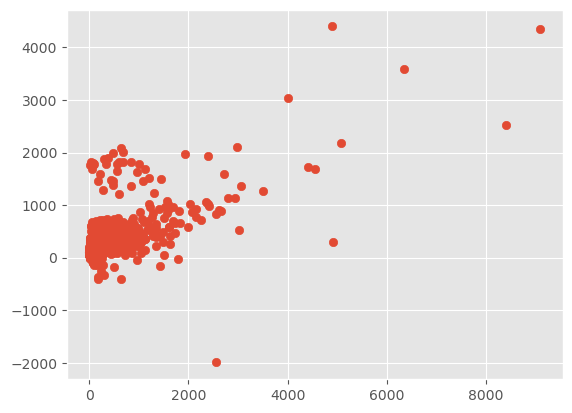

In [92]:
#scatter plot
plt.scatter(y_test,pred)

In [93]:
#add constant to predictor variables
import statsmodels.api as sm
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Sales   R-squared:                       0.377
Model:                            OLS   Adj. R-squared:                  0.375
Method:                 Least Squares   F-statistic:                     215.5
Date:                Sat, 25 Feb 2023   Prob (F-statistic):               0.00
Time:                        18:24:42   Log-Likelihood:                -76125.
No. Observations:                9994   AIC:                         1.523e+05
Df Residuals:                    9965   BIC:                         1.525e+05
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

/var/folders/17/br7lhr0d49z5kcbl73nl58vh0000gn/T/ipykernel_77474/416555715.py:9: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


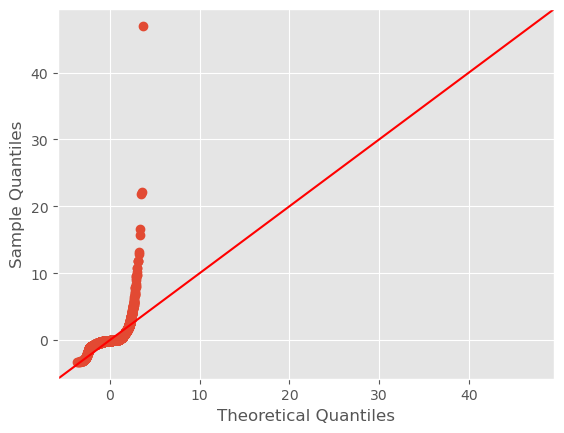

In [94]:
#create the baseline model, using statsmodel
import scipy.stats as stats
import statsmodels as sm
import statsmodels.api as sm


residuals = model.resid
fig = sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True)
fig.show()

/Users/reffer/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


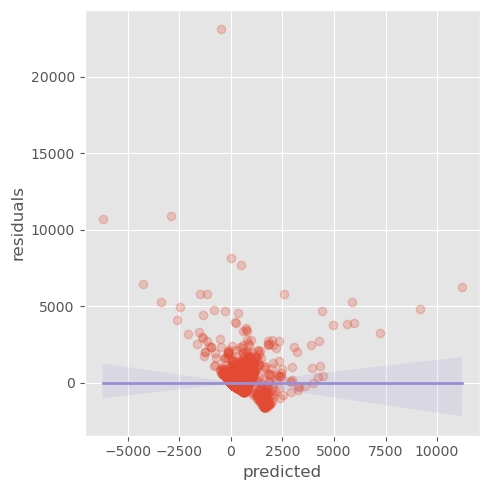

In [95]:
#Homoscedasticity
fig, ax = plt.subplots(figsize=(5, 5))
sns.regplot(model.fittedvalues,model.resid, scatter_kws={'alpha': 0.25}, line_kws={'color': 'C2', 'lw': 2}, ax=ax)
ax.set_xlabel('predicted')
ax.set_ylabel('residuals')
plt.tight_layout()
plt.show()


In [96]:
#Database predictor
data_pred1 = df_dummies3.iloc[:,1:30]
data_pred1.head()

,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,State_Georgia,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
1,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2,1,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
3,0,0,1,0,0,1,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
4,0,0,1,0,0,1,0,0,0,0,...,0,0,0,1,1,0,0,1,0,0


In [97]:
#correlation
data_pred1.corr()

,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,State_Georgia,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
Region_West,1.000000,-0.433561,-0.302067,0.728546,-0.244964,-0.137097,-0.109779,-0.103989,0.336261,-0.094056,...,-0.004048,0.004309,0.003895,-0.015025,-0.016665,0.015273,-0.011804,-0.016212,-0.013835,0.017054
Region_East,-0.433561,1.000000,-0.277670,-0.315869,0.565005,-0.126024,-0.100913,-0.095591,-0.145790,-0.086460,...,0.000952,0.008788,0.004945,-0.002372,0.024471,-0.010748,0.014565,0.030159,0.012841,-0.009076
Region_South,-0.302067,-0.277670,1.000000,-0.220069,-0.156885,0.453862,0.363427,0.344259,-0.101573,0.311375,...,0.013007,-0.001632,-0.004472,0.010100,-0.000485,-0.010882,-0.003933,-0.004262,-0.004274,-0.010047
State_California,0.728546,-0.315869,-0.220069,1.000000,-0.178468,-0.099881,-0.079979,-0.075761,-0.115546,-0.068524,...,0.005195,-0.000059,-0.006962,-0.004357,-0.014641,-0.000069,0.004584,-0.013229,0.005620,0.000358
State_New York,-0.244964,0.565005,-0.156885,-0.178468,1.000000,-0.071204,-0.057016,-0.054009,-0.082372,-0.048850,...,0.000184,0.008955,-0.000380,0.002494,0.019205,-0.014657,0.020222,0.020443,0.021702,-0.018690
State_Florida,-0.137097,-0.126024,0.453862,-0.099881,-0.071204,1.000000,-0.031910,-0.030227,-0.046100,-0.027339,...,-0.002897,0.007784,-0.002394,-0.002061,0.005685,-0.001025,-0.015638,0.004242,-0.018819,0.002681
State_North Carolina,-0.109779,-0.100913,0.363427,-0.079979,-0.057016,-0.031910,1.000000,-0.024204,-0.036914,-0.021892,...,0.014624,0.006831,0.008240,0.007692,-0.008461,0.003385,0.013990,-0.009551,0.014335,0.003693
State_Virginia,-0.103989,-0.095591,0.344259,-0.075761,-0.054009,-0.030227,-0.024204,1.000000,-0.034968,-0.020737,...,0.002893,-0.003661,-0.009400,0.001294,0.004788,-0.044853,0.004655,0.003692,0.004972,-0.044594
State_Washington,0.336261,-0.145790,-0.101573,-0.115546,-0.082372,-0.046100,-0.036914,-0.034968,1.000000,-0.031627,...,-0.010623,0.005039,0.007626,-0.012218,-0.035192,0.045872,-0.009358,-0.036652,-0.008893,0.043435
State_Georgia,-0.094056,-0.086460,0.311375,-0.068524,-0.048850,-0.027339,-0.021892,-0.020737,-0.031627,1.000000,...,0.006446,-0.007797,0.005743,0.006169,0.002374,0.001617,0.009126,0.001392,0.009419,0.001880


In [98]:
data_pred1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9994 entries, 0 to 9993
Data columns (total 28 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Region_West               9994 non-null   uint8  
 1   Region_East               9994 non-null   uint8  
 2   Region_South              9994 non-null   uint8  
 3   State_California          9994 non-null   uint8  
 4   State_New York            9994 non-null   uint8  
 5   State_Florida             9994 non-null   uint8  
 6   State_North Carolina      9994 non-null   uint8  
 7   State_Virginia            9994 non-null   uint8  
 8   State_Washington          9994 non-null   uint8  
 9   State_Georgia             9994 non-null   uint8  
 10  State_Tennessee           9994 non-null   uint8  
 11  Sub-Category_Phones       9994 non-null   uint8  
 12  Sub-Category_Furnishings  9994 non-null   uint8  
 13  Sub-Category_Paper        9994 non-null   uint8  
 14  Sub-Cate

In [99]:
abs(data_pred1.corr()) > 0.75

,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,State_Georgia,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
Region_West,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Region_East,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
Region_South,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
State_California,False,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
State_New York,False,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
State_Florida,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
State_North Carolina,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
State_Virginia,False,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
State_Washington,False,False,False,False,False,False,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
State_Georgia,False,False,False,False,False,False,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False


In [100]:
#Checking how much are correlated the variables
data=data_pred1.corr().abs().stack().reset_index().sort_values(0, ascending=False)
data['pairs'] = list(zip(data.level_0, data.level_1))
data.set_index(['pairs'], inplace = True)
data.drop(columns=['level_1', 'level_0'], inplace = True)
data.columns = ['cc']
data.drop_duplicates(inplace=True)
data

,cc
pairs,
"(Region_West, Region_West)",1.000000
"(Ship Date_year_2016, Order Date_year_2016)",0.985122
"(Order Date_year_2017, Ship Date_year_2017)",0.983056
"(Order Date_year_2015, Ship Date_year_2015)",0.976959
"(State_California, Region_West)",0.728546
"(Category_Technology, Sub-Category_Phones)",0.656261
"(Category_Technology, Category_Office Supplies)",0.586764
"(Region_East, State_New York)",0.565005
"(Region_South, State_Florida)",0.453862


<function seaborn.matrix.heatmap(data, *, vmin=None, vmax=None, cmap=None, center=None, robust=False, annot=None, fmt='.2g', annot_kws=None, linewidths=0, linecolor='white', cbar=True, cbar_kws=None, cbar_ax=None, square=False, xticklabels='auto', yticklabels='auto', mask=None, ax=None, **kwargs)>

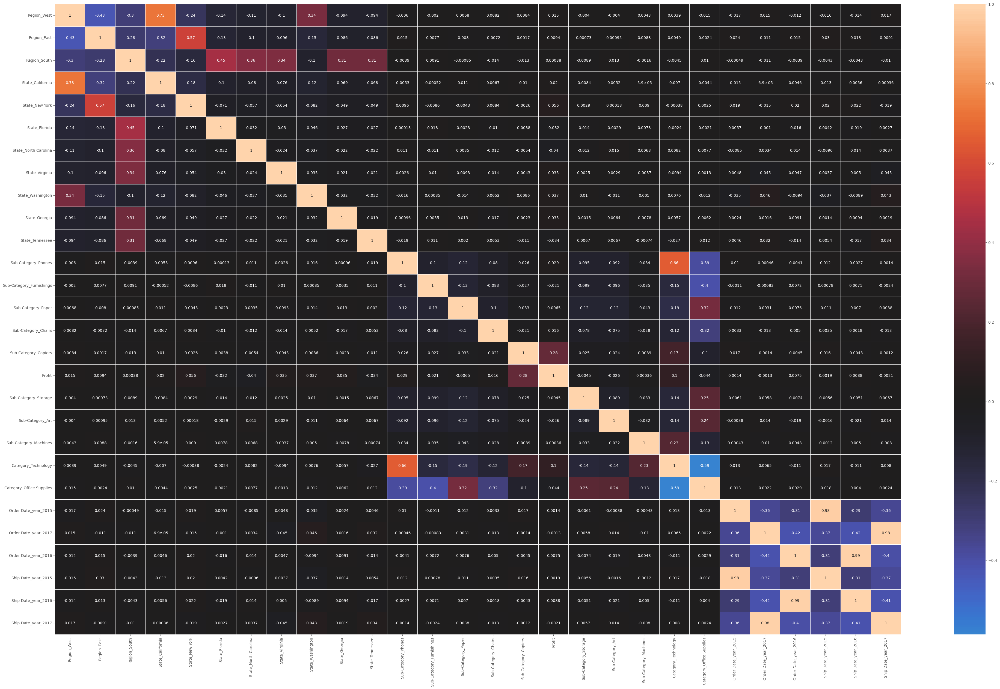

In [101]:
#correlation plot
fig, ax = plt.subplots(figsize=(50, 30))
sns.heatmap(data=data_pred1.corr(), linewidths=0.5, center=0, annot=True, ax=ax)
sns.heatmap

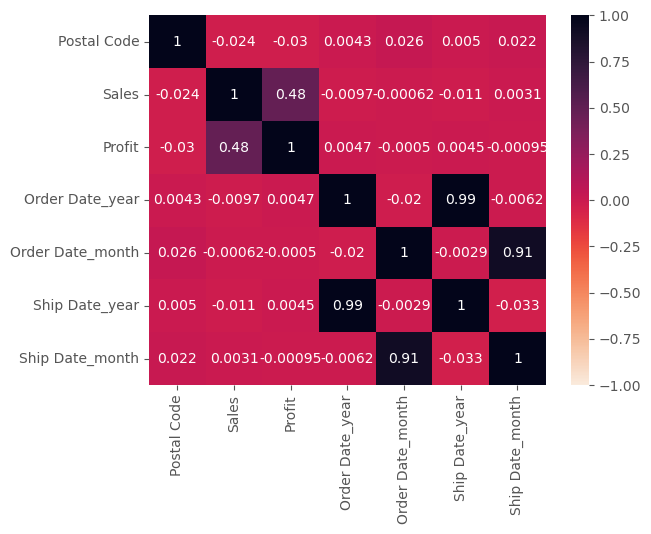

In [102]:
import seaborn as sns

sns.heatmap(df.corr(), vmin=-1, vmax=1,
annot=True,cmap="rocket_r")
plt.show()

In [103]:
#importing data 
df_dummies3.head()

,Sales,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
0,261.9600,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
1,731.9400,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2,14.6200,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
3,957.5775,0,0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,1,0,0
4,22.3680,0,0,1,0,0,1,0,0,0,...,0,0,0,1,1,0,0,1,0,0


In [104]:
#Database predictor
data_pred = df_dummies3.iloc[:,0:29]
data_pred.head()

,Sales,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
0,261.9600,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
1,731.9400,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2,14.6200,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
3,957.5775,0,0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,1,0,0
4,22.3680,0,0,1,0,0,1,0,0,0,...,0,0,0,1,1,0,0,1,0,0


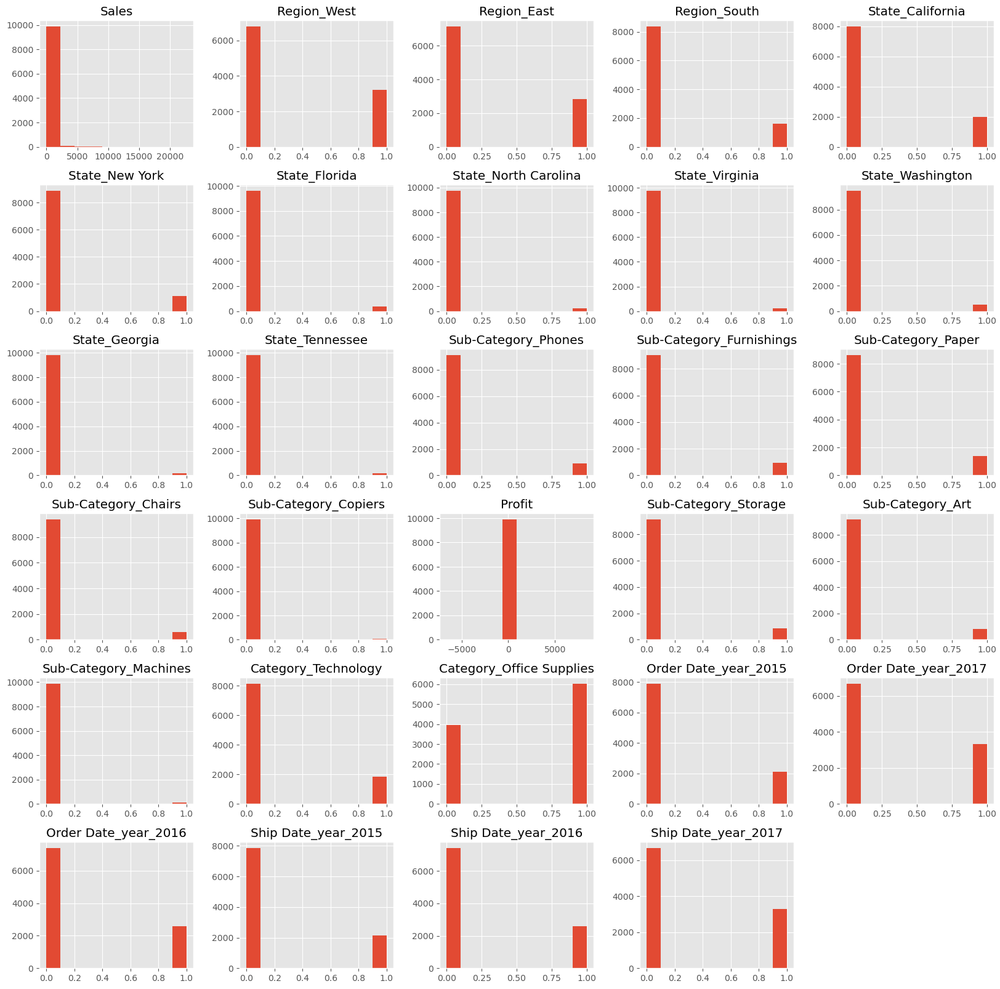

In [105]:
data_pred[['Sales', 'Region_West' ,'Region_East' ,'Region_South', 'State_California', 
                           'State_New York', 'State_Florida', 'State_North Carolina', 'State_Virginia', 
                           'State_Washington', 'State_Georgia', 'State_Tennessee', 'Sub-Category_Phones', 
                           'Sub-Category_Furnishings', 'Sub-Category_Paper', 'Sub-Category_Chairs', 
                           'Sub-Category_Copiers', 'Profit', 'Sub-Category_Storage', 'Sub-Category_Art',
                           'Sub-Category_Machines','Category_Technology', 'Category_Office Supplies',
                           'Order Date_year_2015', 'Order Date_year_2017', 'Order Date_year_2016',
                           'Ship Date_year_2015',  'Ship Date_year_2016', 'Ship Date_year_2017']].hist(figsize  = [20, 20]);

In [106]:
#Dataframe 
new = df_dummies2[['Sales','Profit', 'State_Florida',
                   'State_North Carolina', 'Region_West', 
                   'Category_Office Supplies', 'Category_Technology', 'Sub-Category_Appliances', 'Sub-Category_Art',
                   'Sub-Category_Bookcases', 'Sub-Category_Chairs', 'Sub-Category_Copiers', 'Sub-Category_Fasteners', 
                   'Sub-Category_Furnishings', 'Sub-Category_Labels', 'Sub-Category_Machines', 'Sub-Category_Paper', 
                   'Sub-Category_Phones', 'Sub-Category_Storage', 'Order Date_year_2015']]
new.head()

,Sales,Profit,State_Florida,State_North Carolina,Region_West,Category_Office Supplies,Category_Technology,Sub-Category_Appliances,Sub-Category_Art,Sub-Category_Bookcases,Sub-Category_Chairs,Sub-Category_Copiers,Sub-Category_Fasteners,Sub-Category_Furnishings,Sub-Category_Labels,Sub-Category_Machines,Sub-Category_Paper,Sub-Category_Phones,Sub-Category_Storage,Order Date_year_2015
0,261.9600,41.9136,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1,731.9400,219.5820,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
2,14.6200,6.8714,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,957.5775,-383.0310,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,22.3680,2.5164,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1


In [107]:
df_dummies3= df_dummies2 [['Region_West' ,'Region_East' ,'Region_South', 'State_California', 'State_New York',
                           'State_Florida', 'State_North Carolina', 'State_Virginia', 'State_Washington', 
                           'State_Georgia', 'State_Tennessee','Sub-Category_Phones', 'Sub-Category_Furnishings', 
                           'Sub-Category_Paper', 'Sub-Category_Chairs', 'Sub-Category_Copiers', 'Profit',
                           'Sub-Category_Storage', 'Sub-Category_Art', 'Sub-Category_Machines', 'Category_Technology',
                           'Category_Office Supplies','Order Date_year_2015', 'Order Date_year_2017',
                           'Order Date_year_2016','Ship Date_year_2015',  'Ship Date_year_2016','Ship Date_year_2017']]
 
 


In [108]:
#Database predictor
data_pred = df_dummies2.iloc[:,1:85]
data_pred.head()

,Profit,Order Date_month,Ship Date_month,Order Date_month,Ship Date_month,State_California,State_Florida,State_Georgia,State_New York,State_North Carolina,...,Product Name_4009 Highlighters,Product Name_4009 Highlighters by Sanford,Product Name_50 Colored Long Pencils,"Product Name_6"" Cubicle Wall Clock, Black",Product Name_9-3/4 Diameter Round Wall Clock,"Product Name_ACCOHIDE 3-Ring Binder, Blue, 1""",Product Name_ACCOHIDE Binder by Acco,Product Name_APC 7 Outlet Network SurgeArrest Surge Protector,Product Name_ARKON Windshield Dashboard Air Vent Car Mount Holder,Product Name_AT&T 1070 Corded Phone
0,41.9136,11,11,11,11,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,219.5820,11,11,11,11,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6.8714,6,6,6,6,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,-383.0310,10,10,10,10,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2.5164,10,10,10,10,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [109]:
#correlation
data_pred1.corr()

,Region_West,Region_East,Region_South,State_California,State_New York,State_Florida,State_North Carolina,State_Virginia,State_Washington,State_Georgia,...,Sub-Category_Art,Sub-Category_Machines,Category_Technology,Category_Office Supplies,Order Date_year_2015,Order Date_year_2017,Order Date_year_2016,Ship Date_year_2015,Ship Date_year_2016,Ship Date_year_2017
Region_West,1.000000,-0.433561,-0.302067,0.728546,-0.244964,-0.137097,-0.109779,-0.103989,0.336261,-0.094056,...,-0.004048,0.004309,0.003895,-0.015025,-0.016665,0.015273,-0.011804,-0.016212,-0.013835,0.017054
Region_East,-0.433561,1.000000,-0.277670,-0.315869,0.565005,-0.126024,-0.100913,-0.095591,-0.145790,-0.086460,...,0.000952,0.008788,0.004945,-0.002372,0.024471,-0.010748,0.014565,0.030159,0.012841,-0.009076
Region_South,-0.302067,-0.277670,1.000000,-0.220069,-0.156885,0.453862,0.363427,0.344259,-0.101573,0.311375,...,0.013007,-0.001632,-0.004472,0.010100,-0.000485,-0.010882,-0.003933,-0.004262,-0.004274,-0.010047
State_California,0.728546,-0.315869,-0.220069,1.000000,-0.178468,-0.099881,-0.079979,-0.075761,-0.115546,-0.068524,...,0.005195,-0.000059,-0.006962,-0.004357,-0.014641,-0.000069,0.004584,-0.013229,0.005620,0.000358
State_New York,-0.244964,0.565005,-0.156885,-0.178468,1.000000,-0.071204,-0.057016,-0.054009,-0.082372,-0.048850,...,0.000184,0.008955,-0.000380,0.002494,0.019205,-0.014657,0.020222,0.020443,0.021702,-0.018690
State_Florida,-0.137097,-0.126024,0.453862,-0.099881,-0.071204,1.000000,-0.031910,-0.030227,-0.046100,-0.027339,...,-0.002897,0.007784,-0.002394,-0.002061,0.005685,-0.001025,-0.015638,0.004242,-0.018819,0.002681
State_North Carolina,-0.109779,-0.100913,0.363427,-0.079979,-0.057016,-0.031910,1.000000,-0.024204,-0.036914,-0.021892,...,0.014624,0.006831,0.008240,0.007692,-0.008461,0.003385,0.013990,-0.009551,0.014335,0.003693
State_Virginia,-0.103989,-0.095591,0.344259,-0.075761,-0.054009,-0.030227,-0.024204,1.000000,-0.034968,-0.020737,...,0.002893,-0.003661,-0.009400,0.001294,0.004788,-0.044853,0.004655,0.003692,0.004972,-0.044594
State_Washington,0.336261,-0.145790,-0.101573,-0.115546,-0.082372,-0.046100,-0.036914,-0.034968,1.000000,-0.031627,...,-0.010623,0.005039,0.007626,-0.012218,-0.035192,0.045872,-0.009358,-0.036652,-0.008893,0.043435
State_Georgia,-0.094056,-0.086460,0.311375,-0.068524,-0.048850,-0.027339,-0.021892,-0.020737,-0.031627,1.000000,...,0.006446,-0.007797,0.005743,0.006169,0.002374,0.001617,0.009126,0.001392,0.009419,0.001880


<function seaborn.matrix.heatmap(data, *, vmin=None, vmax=None, cmap=None, center=None, robust=False, annot=None, fmt='.2g', annot_kws=None, linewidths=0, linecolor='white', cbar=True, cbar_kws=None, cbar_ax=None, square=False, xticklabels='auto', yticklabels='auto', mask=None, ax=None, **kwargs)>

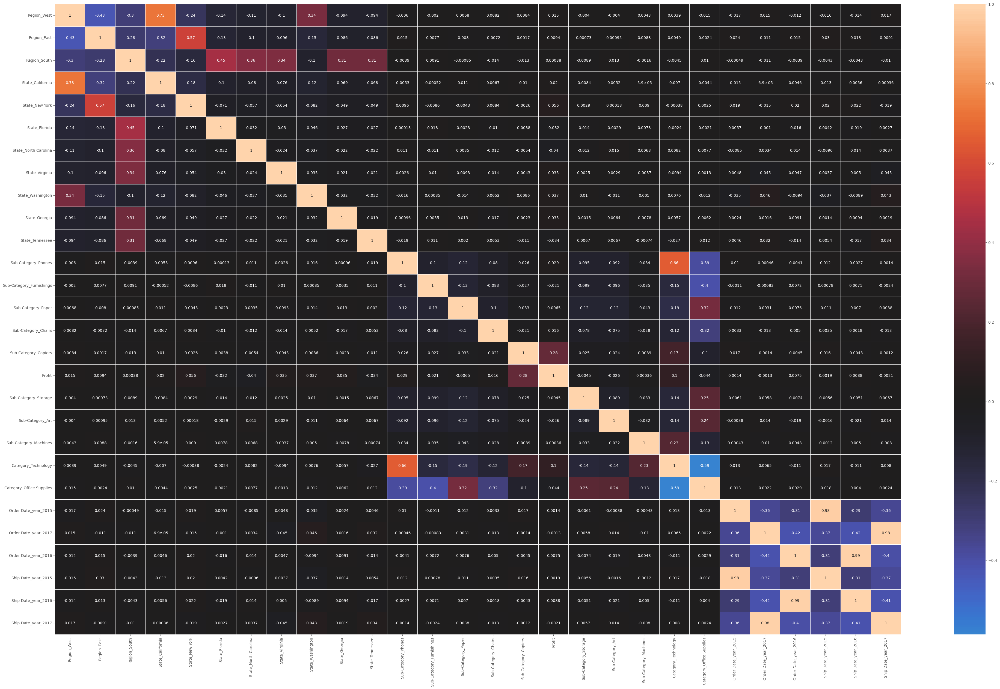

In [110]:
#correlation plot
fig, ax = plt.subplots(figsize=(50, 30))
sns.heatmap(data=data_pred1.corr(), linewidths=0.5, center=0, annot=True, ax=ax)
sns.heatmap

/var/folders/17/br7lhr0d49z5kcbl73nl58vh0000gn/T/ipykernel_77474/416555715.py:9: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


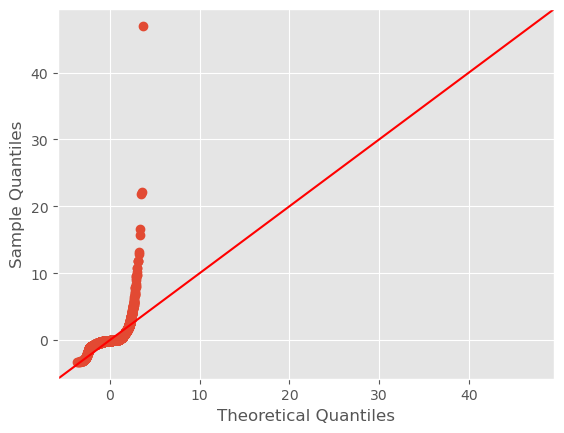

In [111]:
#create the baseline model, using statsmodel
import scipy.stats as stats
import statsmodels as sm
import statsmodels.api as sm


residuals = model.resid
fig = sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True)
fig.show()

In [112]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [113]:
X_train[0:16]

array([[1.        , 0.        , 0.        , 1.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 1.        , 0.        ,
        0.        , 0.44185869, 0.        , 0.        , 0.        ,
        0.        , 1.        , 0.        , 0.        , 1.        ,
        0.        , 1.        , 0.        ],
       [1.        , 0.        , 0.        , 1.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 1.        , 0.        , 0.        , 0.        ,
        0.        , 0.44123583, 0.        , 0.        , 0.        ,
        1.        , 0.        , 0.        , 1.        , 0.        ,
        0.        , 0.        , 1.        ],
       [0.        , 1.        , 0.        , 0.        , 1.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.4370

In [114]:
#Fitting Multiple Linear Regression to the Training set
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [115]:
#Predicting the Test set results
y_pred = regressor.predict(X_test)

In [116]:
math.sqrt(mean_squared_error(y_test, y_pred))

400.4762588525211

In [117]:
r2_score(y_test, y_pred)

0.4546467295229155

In [118]:
#add constant to predictor variables
import statsmodels.api as sm
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Sales   R-squared:                       0.377
Model:                            OLS   Adj. R-squared:                  0.375
Method:                 Least Squares   F-statistic:                     215.5
Date:                Sat, 25 Feb 2023   Prob (F-statistic):               0.00
Time:                        18:25:06   Log-Likelihood:                -76125.
No. Observations:                9994   AIC:                         1.523e+05
Df Residuals:                    9965   BIC:                         1.525e+05
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

(array([6791.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        3203.]),
 array([-0.68677046, -0.47248435, -0.25819825, -0.04391214,  0.17037396,
         0.38466007,  0.59894617,  0.81323228,  1.02751838,  1.24180449,
         1.45609059]),
 <BarContainer object of 10 artists>)

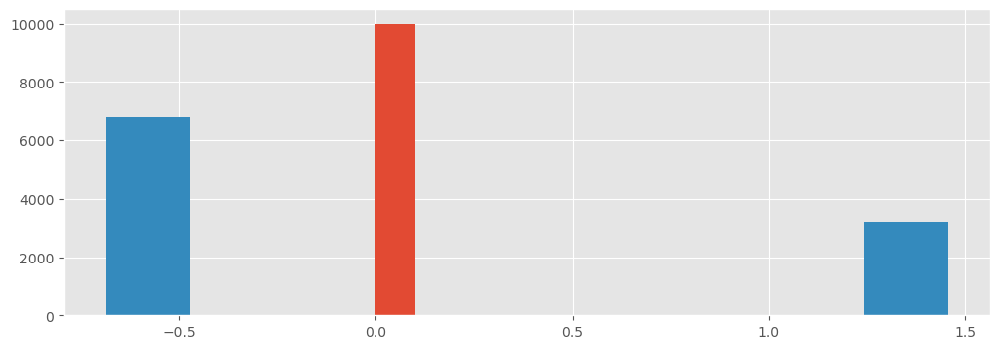

In [119]:
#StandardScaler
#import it and scale the data via its fit_transform() method:
from sklearn.preprocessing import StandardScaler

fig, ax = plt.subplots(figsize=(12, 4))

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

ax.hist(X_std[:,0])
ax.hist(X_std[:,1])

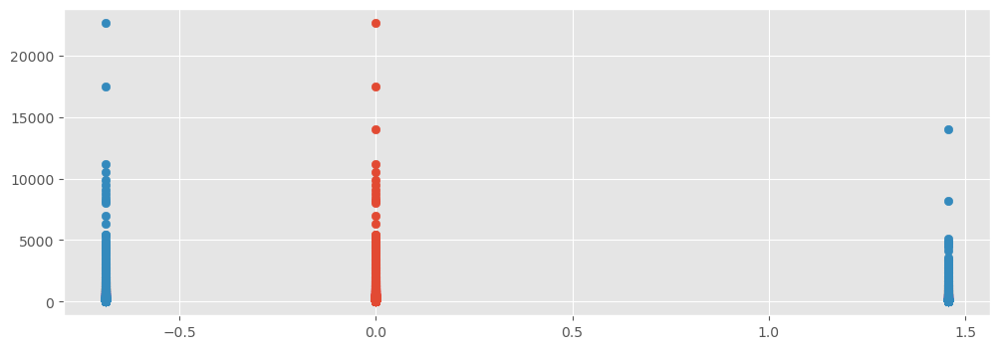

In [120]:
#scatter plot 
fig, ax = plt.subplots(figsize=(12, 4))

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

ax.scatter(X_std[:,0], y)
ax.scatter(X_std[:,1], y)

(array([6791.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        3203.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

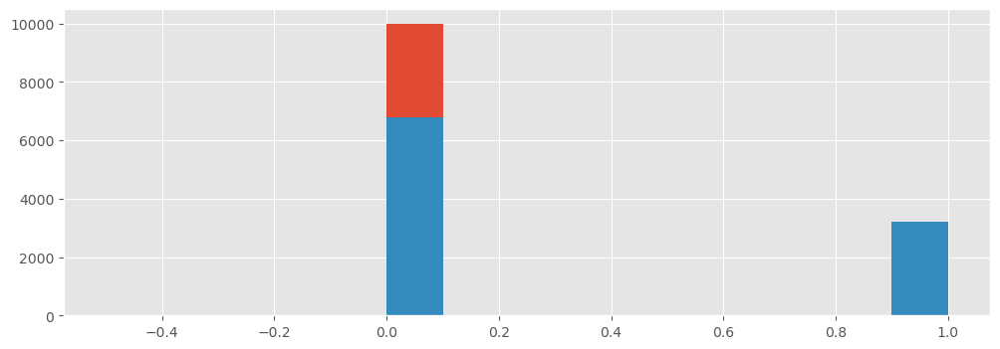

In [121]:
#MinMaxScale
#normalize features, we use the MinMaxScaler class.
from sklearn.preprocessing import MinMaxScaler

fig, ax = plt.subplots(figsize=(12, 4))

scaler = MinMaxScaler()
X_minmax = scaler.fit_transform(X)

ax.hist(X_minmax [:,0])
ax.hist(X_minmax [:,1])

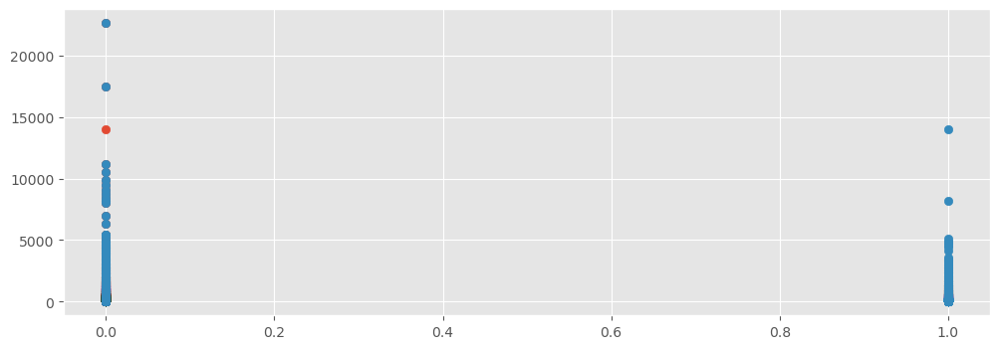

In [122]:
#correlation 
fig, ax = plt.subplots(figsize=(12, 4))

scaler = MinMaxScaler()
X_minmax = scaler.fit_transform(X)

ax.scatter(X_minmax [:,0], y)
ax.scatter(X_minmax [:,1], y)

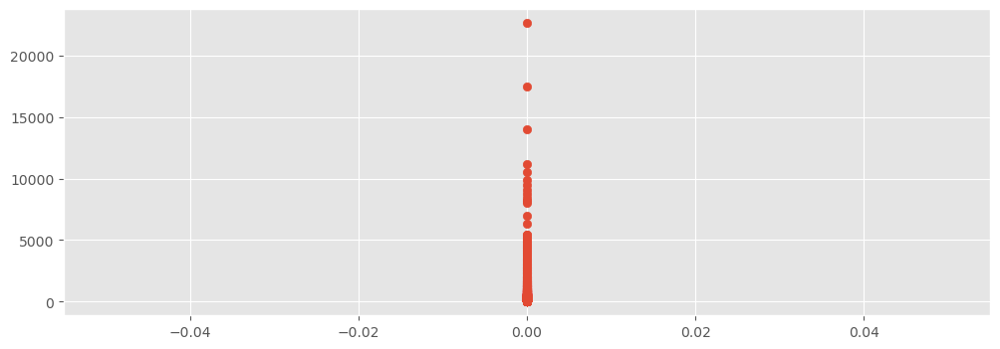

In [123]:
#Effects of Outliers
fig, ax = plt.subplots(figsize=(12, 4))

scaler = MinMaxScaler()
X_minmax = scaler.fit_transform(X)

ax.scatter(X_minmax [:,0], y)

(array([   0.,    0.,    0.,    0.,    0., 9994.,    0.,    0.,    0.,
           0.]),
 array([-0.5, -0.4, -0.3, -0.2, -0.1,  0. ,  0.1,  0.2,  0.3,  0.4,  0.5]),
 <BarContainer object of 10 artists>)

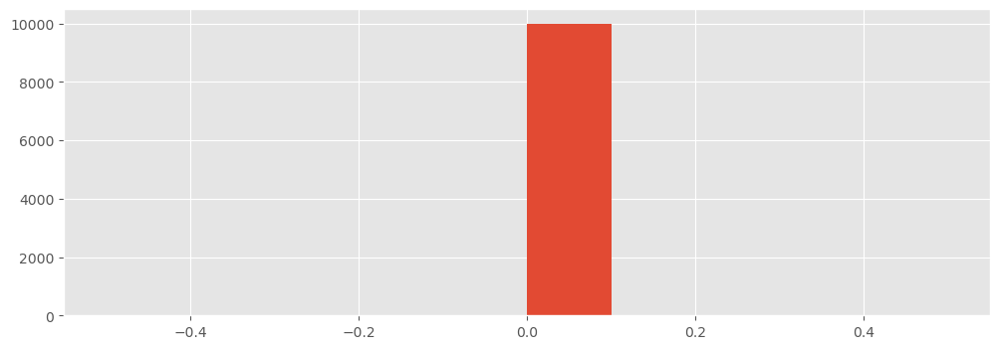

In [124]:
fig, ax = plt.subplots(figsize=(12, 4))

scaler = MinMaxScaler()
X_minmax = scaler.fit_transform(X)

ax.hist(X_minmax [:,0])